# Blood Cell Classifier

The underlying dataset consists of microscopic images (360 x 360 pixels) showing normal white blood cells. The included blood cells are classified as:

1. Neutrophils
2. Eosinophils
3. Basophils
4. Lymphocytes
5. Monocytes
6. Immature Granulocytes (IG)
7. Erythroblasts
8. Platelets/Thrombocytes

In [ ]:
# Import libraries
import tensorflow as tf
import torch
from tensorflow import keras
from keras import layers
from tensorflow.keras.applications.resnet50 import preprocess_input, ResNet50
from tensorflow.keras.layers import Dropout
import os
import gc
import random
import time
import pandas as pd
import numpy as np
import zipfile
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import ConfusionMatrixDisplay, classification_report, confusion_matrix

from sklearn.utils.class_weight import compute_class_weight

from tensorflow.keras.applications.efficientnet import EfficientNetB3, preprocess_input as preprocess_input_effnet
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input as preprocess_input_inception

sns.set_theme(style="ticks")
sns.set_style('darkgrid')

In [ ]:
SEED = 41

os.environ['PYTHONHASHSEED'] = str(SEED)
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

### helper Functions

In [ ]:
# Function to plot training history
def plot_training_history(history, model_name):
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'{model_name} Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

In [ ]:
# Function to evaluate the model and print accuracy, classification report, and confusion matrices
def evaluate_model(model, test_dataset, model_name, class_names):
    # Evaluate model on the test set
    test_loss, test_accuracy = model.evaluate(test_dataset)

    # Get predictions
    y_true = np.concatenate([y for x, y in test_dataset], axis=0)
    y_pred = np.argmax(model.predict(test_dataset), axis=-1)

        # Compute metrics and CIs
    test_accuracy = accuracy_score(y_true, y_pred)
    ci = compute_metrics_with_ci(y_true, y_pred)

    # Print classification report
    print(f'Classification Report for {model_name}:\n')
    print(classification_report(y_true, y_pred, target_names=class_names))

    # Print confidence intervals
    print(f"\nConfidence Intervals (95%) for {model_name}:")
    print(f"Accuracy: {test_accuracy:.4f} ({ci['accuracy'][0]:.4f} - {ci['accuracy'][1]:.4f})")
    print(f"Macro Precision: {ci['precision_macro'][0]:.4f} - {ci['precision_macro'][1]:.4f}")
    print(f"Macro Recall: {ci['recall_macro'][0]:.4f} - {ci['recall_macro'][1]:.4f}")
    print(f"Weighted Precision: {ci['precision_weighted'][0]:.4f} - {ci['precision_weighted'][1]:.4f}")
    print(f"Weighted Recall: {ci['recall_weighted'][0]:.4f} - {ci['recall_weighted'][1]:.4f}")

    # Compute confusion matrices
    cm = confusion_matrix(y_true, y_pred)

    # Create subplots
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # Confusion matrix (absolute values)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[0])
    axes[0].set_title(f'Confusion Matrix for {model_name}')
    axes[0].set_xlabel('Predicted Label')
    axes[0].set_ylabel('True Label')

    # Confusion matrix (percentages)
    cm_percentage = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    sns.heatmap(cm_percentage, annot=True, fmt='.1%', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[1])
    axes[1].set_title('Confusion Matrix (Percentages)')
    axes[1].set_xlabel('Predicted Label')
    axes[1].set_ylabel('True Label')

    # Confusion matrix (errors)
    sample_weight = (y_true != y_pred).astype(int)
    cm_errors = confusion_matrix(y_true, y_pred, sample_weight=sample_weight)
    sns.heatmap(cm_errors, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[2])
    axes[2].set_title('Confusion Matrix (Errors)')
    axes[2].set_xlabel('Predicted Label')
    axes[2].set_ylabel('True Label')

    plt.tight_layout()
    plt.show()

    return test_accuracy, y_true, y_pred

# Evaluate models and collect predictions
model_predictions = {}

In [ ]:
def measure_inference_time(model, dataset, num_batches=100):
    """Measure average inference time per sample in milliseconds"""
    # Warm-up
    for batch, _ in dataset.take(1):
        _ = model.predict(batch, verbose=0)

    # Benchmark
    total_time = 0
    sample_count = 0
    for batch_idx, (batch, labels) in enumerate(dataset):
        if batch_idx >= num_batches:
            break
        start_time = time.perf_counter()
        _ = model.predict(batch, verbose=0)
        total_time += time.perf_counter() - start_time
        sample_count += batch.shape[0]

    return (total_time / sample_count) * 1000  # milliseconds per sample

def create_comparison_table(models_dict):
    """Create comparison DataFrame from model metrics"""
    comparison_data = []

    for name, metrics in models_dict.items():
        comparison_data.append({
            'Model': name,
            'Inference Time (ms)': f"{metrics['inference_time']:.2f}",
            'Parameters': f"{metrics['parameters']/1e6:.1f}M",
            'Validation Accuracy': f"{metrics['val_accuracy']:.4f}"
        })

    return pd.DataFrame(comparison_data)

# Initialize comparison dictionary
model_metrics = {}

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score

def compute_metrics_with_ci(y_true, y_pred, n_bootstraps=1000, confidence_level=0.95):
    alpha = (1 - confidence_level) / 2
    percentiles = [alpha * 100, (1 - alpha) * 100]

    metrics = {
        'accuracy': [],
        'precision_macro': [],
        'recall_macro': [],
        'precision_weighted': [],
        'recall_weighted': []
    }

    rng = np.random.RandomState(42)

    for _ in range(n_bootstraps):
        indices = rng.choice(len(y_true), len(y_true), replace=True)
        y_true_boot = y_true[indices]
        y_pred_boot = y_pred[indices]

        metrics['accuracy'].append(accuracy_score(y_true_boot, y_pred_boot))
        metrics['precision_macro'].append(precision_score(y_true_boot, y_pred_boot, average='macro'))
        metrics['recall_macro'].append(recall_score(y_true_boot, y_pred_boot, average='macro'))
        metrics['precision_weighted'].append(precision_score(y_true_boot, y_pred_boot, average='weighted'))
        metrics['recall_weighted'].append(recall_score(y_true_boot, y_pred_boot, average='weighted'))

    ci = {
        k: (np.percentile(v, percentiles[0]), np.percentile(v, percentiles[1]))
        for k, v in metrics.items()
    }
    return ci


In [ ]:
def clean_training_environment():
    tf.keras.backend.clear_session()
    gc.collect()
    # Reset seed chain after cleanup
    tf.random.set_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

## 1. Import and preprocess data

The data is first extracted from a zip file and then loaded into a TensorFlow dataset. The image size is reduced to 224 x 224 pixels, the images in the dataset are shuffled and batched to 32, and 20% of the images are kept as test data. The remaining 80% is again divided into 80% training data and 20% validation data, resulting in a training set with 64%, a validation set with 16% and a test set with 20% of the images.

In [ ]:
# Import and prepare the first split of datasets
path = os.path.join("/kaggle/input/blood-cells-image-dataset/bloodcells_dataset")

BATCH_SIZE = 32
IMG_HEIGHT = 224
IMG_WIDTH = 224
dataset, test_dataset = keras.utils.image_dataset_from_directory(directory=path,
                                                                 image_size=(IMG_WIDTH, IMG_HEIGHT),
                                                                 batch_size=BATCH_SIZE,
                                                                 label_mode="int",
                                                                 validation_split=0.2,
                                                                 subset="both",
                                                                 shuffle=True,
                                                                 seed=SEED)

# Get class names
class_names = dataset.class_names
print(class_names)

Found 17092 files belonging to 8 classes.
Using 13674 files for training.
Using 3418 files for validation.
['basophil', 'eosinophil', 'erythroblast', 'ig', 'lymphocyte', 'monocyte', 'neutrophil', 'platelet']


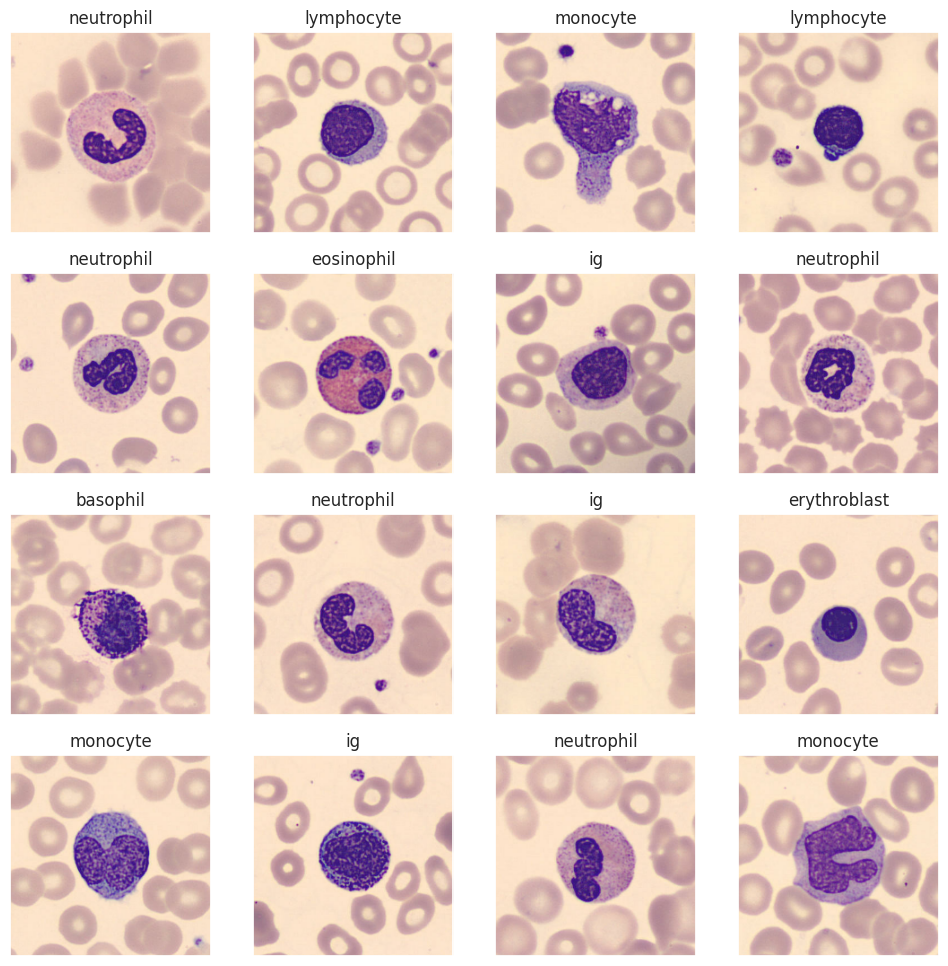

In [ ]:
# Plot 16 images from the dataset as examples
fig, ax = plt.subplots(4, 4, figsize=(12,12))
ax = ax.flat
for images, labels in dataset.take(1):
  for i in range(16):
    ax[i].set_title(class_names[labels[i].numpy()])
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].imshow(images[i].numpy().astype("uint8"))

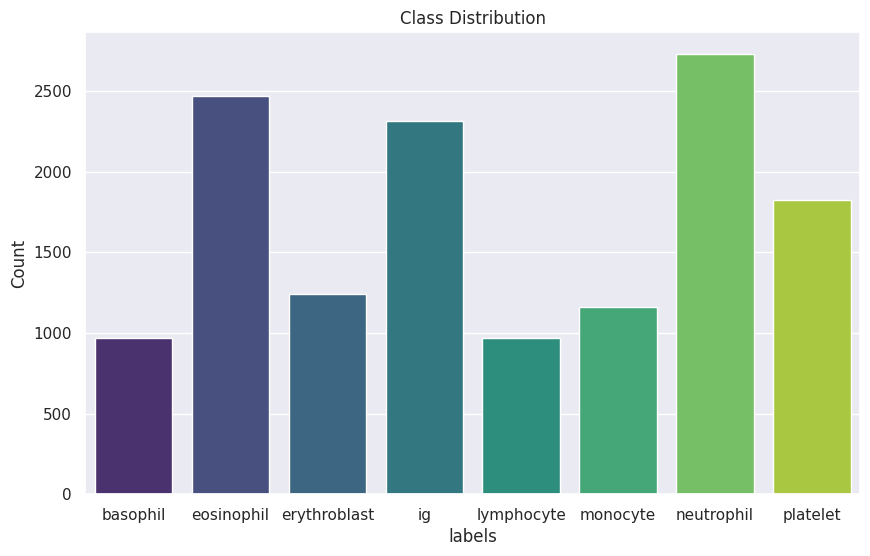

In [ ]:
labels = np.concatenate([label for image, label in dataset], axis=0)
unique, counts = np.unique(labels, return_counts=True)

# Prepare the data for the bar plot
labelscount = pd.DataFrame({
    'labels': class_names,
    'count': counts
})

# Create a bar plot using Seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='labels', y='count', data=labelscount, palette='viridis')

# Add title and labels
plt.title('Class Distribution')
plt.ylabel('Count')

# Show the plot
plt.show()

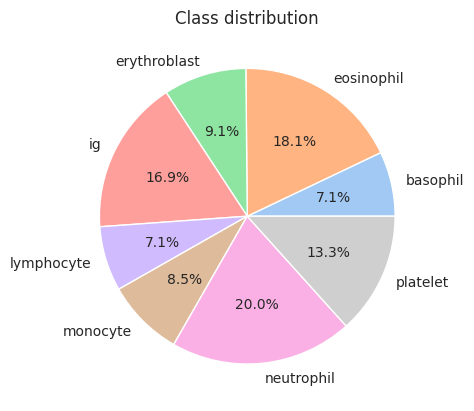

In [ ]:
plt.pie(x=counts, labels=class_names, autopct='%.1f%%', textprops={'size': 'smaller'},
        colors=sns.color_palette('pastel')[0:8])
plt.title("Class distribution")
plt.show()

In [ ]:
# Split dataset in train and validation set
num_elements = len(dataset)
train_size = int(0.8 * num_elements)
val_dataset = dataset.skip(train_size).prefetch(tf.data.AUTOTUNE)
train_dataset = dataset.take(train_size).prefetch(tf.data.AUTOTUNE)

# Check length
len(train_dataset), len(val_dataset), len(test_dataset)

(342, 86, 107)

In [ ]:
# Check format
for image_batch, labels_batch in train_dataset.take(1):
  print(f"Train data: {image_batch.shape}")
  print(f"Train labels: {labels_batch.shape}")

for image_batch, labels_batch in val_dataset.take(1):
  print(f"Validation data: {image_batch.shape}")
  print(f"Validation labels: {labels_batch.shape}")

for image_batch, labels_batch in test_dataset.take(1):
  print(f"Test data: {image_batch.shape}")
  print(f"Test labels: {labels_batch.shape}")

Train data: (32, 224, 224, 3)
Train labels: (32,)
Validation data: (32, 224, 224, 3)
Validation labels: (32,)
Test data: (32, 224, 224, 3)
Test labels: (32,)


In [ ]:
# Check pixel intesities
for image, label in train_dataset.take(1):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))

tf.Tensor(255.0, shape=(), dtype=float32)
tf.Tensor(3.8483279, shape=(), dtype=float32)


**Conclusion:**

* The 8 classes are unbalanced, with the most common class being neutrophils with 19.4% of all images and the least common class being lymphocytes with 7.1%. Thus, the accuracy of a random model would be 19.4%.
* Pixel intensities range from 3.5 to 255. Therefore, rescaling the pixel intesities is appropriate.

## 2. class Weighing

In [ ]:
# Compute class weights to handle imbalance
train_labels = np.concatenate([y for x, y in train_dataset], axis=0)
class_weights = compute_class_weight(class_weight='balanced',
                                    classes=np.unique(train_labels),
                                    y=train_labels)
class_weights = {i: weight for i, weight in enumerate(class_weights)}
print("Class Weights:", class_weights)

Class Weights: {0: 1.7185929648241205, 1: 0.6983154670750383, 2: 1.3874239350912778, 3: 0.7311598075895244, 4: 1.7697283311772316, 5: 1.509933774834437, 6: 0.6307053941908713, 7: 0.921832884097035}


## 3. Data Augmentation

Add a built-in data augmentation layer.
Data augmentation prevent overfitting, allowing a more complex CNN architecture to be built.


In [ ]:
# Set up data augmentation layers
data_augmentation = keras.Sequential([
    keras.layers.RandomFlip("horizontal_and_vertical", seed=SEED),
    keras.layers.RandomRotation(0.4, seed=SEED)
    ])

In [ ]:
# Create a lab-book to track the different experiments
lab_book = {}

early_cb_custom = keras.callbacks.EarlyStopping(
    patience=5,
    restore_best_weights=True,
    monitor="val_accuracy",
    min_delta=0.005
)

## 4. Models Training

### 4.1 Custom CNN

Model: "Model_CustomCNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling (Rescaling)                │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential (Sequential)              │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 224, 224, 32)        │           2,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 112, 112, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 56, 56, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 28, 28, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 14, 14, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 50176)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       6,422,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 8)                   │             520 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,821,384 (26.02 MB)

 Trainable params: 6,821,384 (26.02 MB)

 Non-trainable params: 0 (0.00 B)

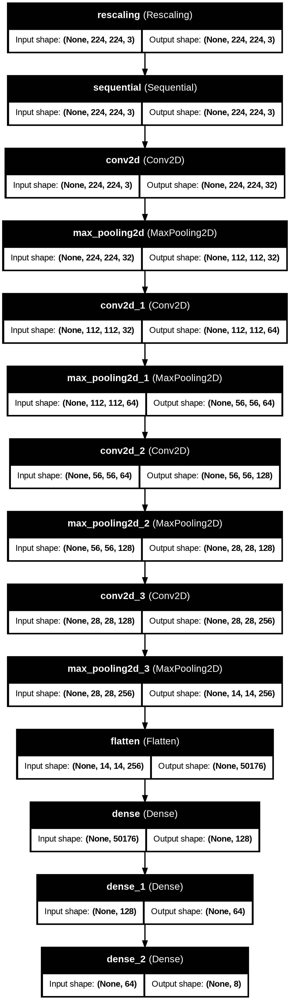

In [ ]:
from tensorflow.keras.utils import plot_model

# 1. Custom CNN Model
name = "Model_CustomCNN"

# Build model
tf.random.set_seed(SEED)
model_custom = keras.Sequential([
    layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
    layers.Rescaling(1./255),
    data_augmentation,
    layers.Conv2D(filters=32, kernel_size=(5,5),
                  padding="same", activation="relu",
                  kernel_initializer="he_normal"),
    layers.MaxPool2D(),
    layers.Conv2D(filters=64, kernel_size=(3,3),
                  padding="same", activation="relu",
                  kernel_initializer="he_normal"),
    layers.MaxPool2D(),
    layers.Conv2D(filters=128, kernel_size=(3,3),
                  padding="same", activation="relu",
                  kernel_initializer="he_normal"),
    layers.MaxPool2D(),
    layers.Conv2D(filters=256, kernel_size=(3,3),
                  padding="same", activation="relu",
                  kernel_initializer="he_normal"),
    layers.MaxPool2D(),
    layers.Flatten(),
    layers.Dense(128, activation="relu"),
    layers.Dense(64, activation="relu"),
    layers.Dense(8, activation="softmax")
], name=name)

model_custom.summary()

# Save model summary as an image
plot_model(model_custom, to_file='model_cnn_summary.png', show_shapes=True, show_layer_names=True)


In [ ]:
# Compile model with reduced learning rate
model_custom.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
                     optimizer=keras.optimizers.Adam(learning_rate=0.0001),
                     metrics=["accuracy"])

# Fit model WITH CLASS WEIGHTS
history_custom = model_custom.fit(train_dataset,
                                  validation_data=val_dataset,
                                  epochs=100,
                                  callbacks=[early_cb_custom],
                                  class_weight=class_weights)

# Write lab-book
train_accuracy_custom = model_custom.evaluate(train_dataset)[1]
val_accuracy_custom = model_custom.evaluate(val_dataset)[1]
lab_book[name] = {"train_accuracy": train_accuracy_custom, "val_accuracy": val_accuracy_custom}

# Extract loss values for CNN model
cnn_loss = history_custom.history['loss']
cnn_val_loss = history_custom.history['val_loss']

model_metrics[name] = {
    'inference_time': measure_inference_time(model_custom, test_dataset),
    'parameters': model_custom.count_params(),
    'val_accuracy': max(history_custom.history['val_accuracy'])
}

Epoch 1/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 39s 94ms/step - accuracy: 0.3133 - loss: 1.8166 - val_accuracy: 0.6850 - val_loss: 0.9250
Epoch 2/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 32s 94ms/step - accuracy: 0.7358 - loss: 0.7546 - val_accuracy: 0.7410 - val_loss: 0.8363
Epoch 3/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 33s 97ms/step - accuracy: 0.8316 - loss: 0.4862 - val_accuracy: 0.8326 - val_loss: 0.5074
Epoch 4/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 34s 100ms/step - accuracy: 0.8620 - loss: 0.4062 - val_accuracy: 0.8150 - val_loss: 0.5492
Epoch 5/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 34s 98ms/step - accuracy: 0.8816 - loss: 0.3442 - val_accuracy: 0.8659 - val_loss: 0.3951
Epoch 6/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 34s 98ms/step - accuracy: 0.8964 - loss: 0.3035 - val_accuracy: 0.8619 - val_loss: 0.3942
Epoch 7/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 34s 98ms/step - accuracy: 0.9057 - loss: 0.2783 - val_accuracy: 0.8971 - val_loss: 0.3066
Epoch 8/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 34s 98ms/step - accuracy: 0.9186 - loss: 

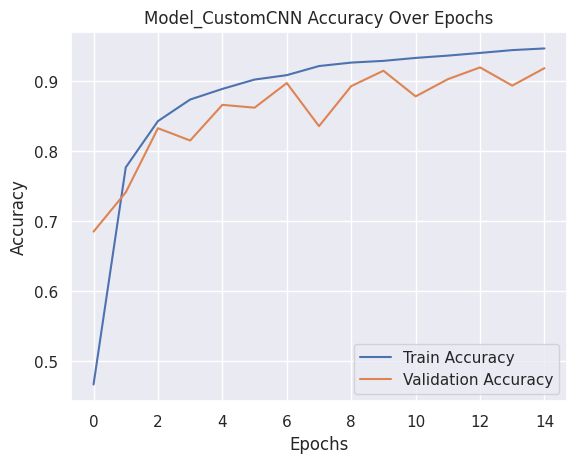

In [ ]:
# Plot training history
plot_training_history(history_custom, name)

107/107 ━━━━━━━━━━━━━━━━━━━━ 3s 27ms/step - accuracy: 0.9135 - loss: 0.2531
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step
Classification Report for Custom CNN:

              precision    recall  f1-score   support

    basophil       0.65      0.97      0.78       250
  eosinophil       0.98      0.97      0.97       646
erythroblast       0.92      0.89      0.90       309
          ig       0.94      0.74      0.83       583
  lymphocyte       0.95      0.98      0.96       245
    monocyte       0.83      0.94      0.88       259
  neutrophil       0.97      0.93      0.95       601
    platelet       0.98      0.99      0.99       525

    accuracy                           0.92      3418
   macro avg       0.90      0.93      0.91      3418
weighted avg       0.93      0.92      0.92      3418


Confidence Intervals (95%) for Custom CNN:
Accuracy: 0.9184 (0.9093 - 0.9272)
Macro Precision: 0.8942 - 0.9146
Macro Recall: 0.9176 - 0.9351
Weighted Precision: 0.9230 - 0.9376
Weighted Recal

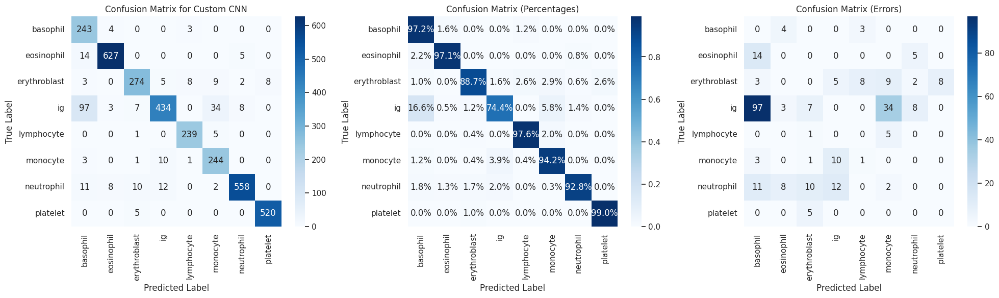

In [ ]:
# Custom CNN
cnn_acc, y_true_cnn, y_pred_cnn = evaluate_model(model_custom, test_dataset, "Custom CNN", class_names)
model_predictions["Custom CNN"] = y_pred_cnn

In [ ]:
clean_training_environment()

In [ ]:
print(f"Active TF graphs: {len(tf.compat.v1.get_default_graph().as_graph_def().node)} nodes")


Active TF graphs: 0 nodes


### 4.2 ResNet

In [ ]:
from tensorflow.keras.layers import Dropout

# Define a callback to reduce the dropout rate
class ReduceDropoutCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        if epoch == 10:  # After 10 epochs, reduce the dropout rate
            self.model.layers[-2].rate = 0.2  # Reduce Dropout rate from 0.5 to 0.2
            print("\nReduced Dropout rate to 0.2")

# Instantiate the callback
reduce_dropout_callback = ReduceDropoutCallback()

early_cb_resnet = keras.callbacks.EarlyStopping(
    patience=5,
    restore_best_weights=True,
    monitor="val_accuracy",
    min_delta=0.005
)

In [ ]:
# Prepare data for ResNet50 input
train_dataset_resnet = train_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)
val_dataset_resnet = val_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)
test_dataset_resnet = test_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)

# Check format
for image_batch, labels_batch in train_dataset_resnet.take(1):
  print(f"Train data: {image_batch.shape}")
  print(f"Train labels: {labels_batch.shape}")

for image_batch, labels_batch in val_dataset_resnet.take(1):
  print(f"Validation data: {image_batch.shape}")
  print(f"Validation labels: {labels_batch.shape}")

for image_batch, labels_batch in test_dataset_resnet.take(1):
  print(f"Test data: {image_batch.shape}")
  print(f"Test labels: {labels_batch.shape}")

Train data: (32, 224, 224, 3)
Train labels: (32,)
Validation data: (32, 224, 224, 3)
Validation labels: (32,)
Test data: (32, 224, 224, 3)
Test labels: (32,)


In [ ]:
# ResNet50 Model with Dropout
name = "Model_ResNet50"
feature_extraction_layer = ResNet50(include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
feature_extraction_layer.trainable = True

model_resnet = keras.Sequential([
    data_augmentation,
    feature_extraction_layer,
    layers.GlobalAvgPool2D(),
    Dropout(0.5),  # Add Dropout with high rate initially
    layers.Dense(8, activation="softmax")
], name=name)

# Compile the model
model_resnet.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
                     optimizer=keras.optimizers.Adam(learning_rate=0.0001),
                     metrics=["accuracy"])

# Train ResNet50 with ReduceDropoutCallback
history_resnet = model_resnet.fit(train_dataset_resnet,
                                  validation_data=val_dataset_resnet,
                                  epochs=100,
                                  callbacks=[early_cb_resnet, reduce_dropout_callback],
                                  class_weight=class_weights)

# Write lab-book
train_accuracy = model_resnet.evaluate(train_dataset_resnet)[1]
val_accuracy = model_resnet.evaluate(val_dataset_resnet)[1]
lab_book[name] = {"train_accuracy": train_accuracy, "val_accuracy": val_accuracy}

# Extract loss values
resnet_loss = history_resnet.history['loss']
resnet_val_loss = history_resnet.history['val_loss']

model_metrics[name] = {
    'inference_time': measure_inference_time(model_resnet, test_dataset_resnet),
    'parameters': model_resnet.count_params(),
    'val_accuracy': max(history_resnet.history['val_accuracy'])
}

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 250s 630ms/step - accuracy: 0.8388 - loss: 0.4928 - val_accuracy: 0.9447 - val_loss: 0.1842
Epoch 2/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 620ms/step - accuracy: 0.9643 - loss: 0.1050 - val_accuracy: 0.9689 - val_loss: 0.0924
Epoch 3/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 620ms/step - accuracy: 0.9762 - loss: 0.0664 - val_accuracy: 0.9070 - val_loss: 0.3276
Epoch 4/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 620ms/step - accuracy: 0.9796 - loss: 0.0656 - val_accuracy: 0.9758 - val_loss: 0.0781
Epoch 5/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 620ms/step - accuracy: 0.9832 - loss: 0.0500 - val_accuracy: 0.9755 - val_loss: 0.0835
Epoch 6/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 619ms/step - accuracy: 0.9833 - loss: 0.0386 - val_accuracy: 0.9857 - val_loss: 0.0426
Epoch 7/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 212s 619ms/step - accuracy: 0.9866 - loss: 0.0416 - val_accuracy: 0.9674 - val_loss: 0.1157
Epoch 8/100
342/34

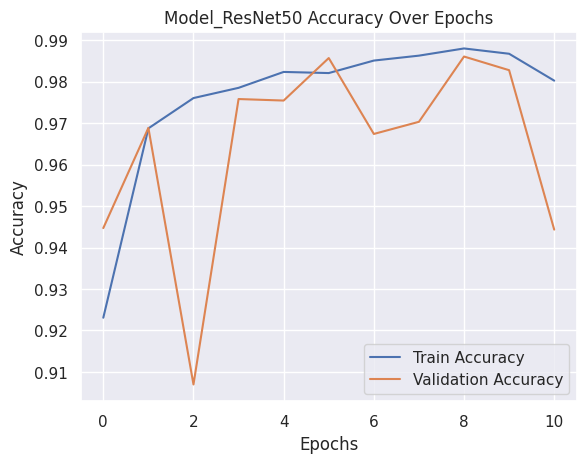

In [ ]:
# Plot training history
plot_training_history(history_resnet, name)

107/107 ━━━━━━━━━━━━━━━━━━━━ 16s 152ms/step - accuracy: 0.9893 - loss: 0.0292
107/107 ━━━━━━━━━━━━━━━━━━━━ 17s 147ms/step
Classification Report for ResNet50:

              precision    recall  f1-score   support

    basophil       0.99      1.00      1.00       250
  eosinophil       1.00      1.00      1.00       646
erythroblast       0.99      0.99      0.99       309
          ig       0.98      0.97      0.97       583
  lymphocyte       0.99      0.99      0.99       245
    monocyte       0.98      0.98      0.98       259
  neutrophil       0.98      0.98      0.98       601
    platelet       1.00      1.00      1.00       525

    accuracy                           0.99      3418
   macro avg       0.99      0.99      0.99      3418
weighted avg       0.99      0.99      0.99      3418


Confidence Intervals (95%) for ResNet50:
Accuracy: 0.9883 (0.9848 - 0.9918)
Macro Precision: 0.9846 - 0.9924
Macro Recall: 0.9851 - 0.9927
Weighted Precision: 0.9848 - 0.9919
Weighted Recal

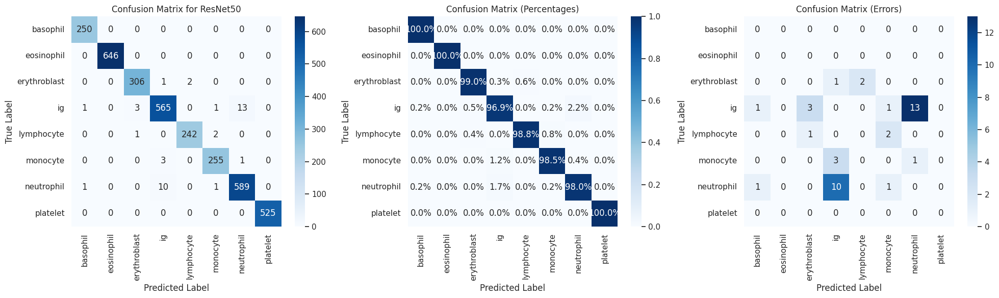

In [ ]:
resnet_accuracy, y_true_res, y_pred_res = evaluate_model(model_resnet, test_dataset_resnet, "ResNet50", class_names)
model_predictions["ResNet50"] = y_pred_res

In [ ]:
#clean_training_environment()

In [ ]:
print(f"Active TF graphs: {len(tf.compat.v1.get_default_graph().as_graph_def().node)} nodes")

Active TF graphs: 0 nodes


### 4.3 InceptionV3

In [ ]:
early_cb_inception = keras.callbacks.EarlyStopping(
    patience=5,
    restore_best_weights=True,
    monitor="val_accuracy",
    min_delta=0.005
)

In [ ]:
# Prepare data for InceptionV3 input
train_dataset_inception = train_dataset.map(lambda X, y: (preprocess_input_inception(X), y)).prefetch(tf.data.AUTOTUNE)
val_dataset_inception = val_dataset.map(lambda X, y: (preprocess_input_inception(X), y)).prefetch(tf.data.AUTOTUNE)
test_dataset_inception = test_dataset.map(lambda X, y: (preprocess_input_inception(X), y)).prefetch(tf.data.AUTOTUNE)

In [ ]:
# InceptionV3 Model with Dropout
name = "Model_InceptionV3"
feature_extraction_layer_inception = InceptionV3(include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
feature_extraction_layer_inception.trainable = True

model_inception = keras.Sequential([
    data_augmentation,
    feature_extraction_layer_inception,
    layers.GlobalAvgPool2D(),
    Dropout(0.5),  # Add Dropout with high rate initially
    layers.Dense(8, activation="softmax")
], name=name)

# Compile the model
model_inception.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
                        optimizer=keras.optimizers.Adam(learning_rate=0.0001),
                        metrics=["accuracy"])

# Train InceptionV3 with ReduceDropoutCallback
history_inception = model_inception.fit(train_dataset_inception,
                                        validation_data=val_dataset_inception,
                                        epochs=100,
                                        callbacks=[early_cb_inception, reduce_dropout_callback],
                                        class_weight=class_weights)  # Added class_weight

# Log accuracy
train_accuracy_inception = model_inception.evaluate(train_dataset_inception)[1]
val_accuracy_inception = model_inception.evaluate(val_dataset_inception)[1]
lab_book[name] = {"train_accuracy": train_accuracy_inception, "val_accuracy": val_accuracy_inception}

# Extract loss values
inception_loss = history_inception.history['loss']
inception_val_loss = history_inception.history['val_loss']

model_metrics[name] = {
    'inference_time': measure_inference_time(model_inception, test_dataset_inception),
    'parameters': model_inception.count_params(),
    'val_accuracy': max(history_inception.history['val_accuracy'])
}

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 181s 415ms/step - accuracy: 0.7998 - loss: 0.6100 - val_accuracy: 0.9711 - val_loss: 0.0942
Epoch 2/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 138s 403ms/step - accuracy: 0.9677 - loss: 0.0975 - val_accuracy: 0.9780 - val_loss: 0.0703
Epoch 3/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 138s 403ms/step - accuracy: 0.9772 - loss: 0.0661 - val_accuracy: 0.9791 - val_loss: 0.0685
Epoch 4/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 137s 402ms/step - accuracy: 0.9780 - loss: 0.0631 - val_accuracy: 0.9670 - val_loss: 0.1016
Epoch 5/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 137s 401ms/step - accuracy: 0.9819 - loss: 0.0464 - val_accuracy: 0.9740 - val_loss: 0.0678
Epoch 6/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 138s 402ms/step - accuracy: 0.9821 - loss: 0.0486 - val_accuracy: 0.9795 - val_loss: 0.0717
Epoch 7/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 137s 402ms/step - accuracy: 0.9820 - loss: 0.0535 - val_accuracy: 0.9861 - val_loss: 0.0455
Epoch 8/100
342/34

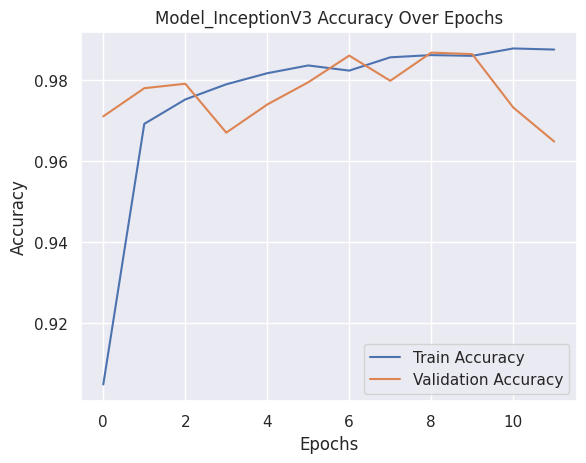

In [ ]:
# Plot training history
plot_training_history(history_inception, name)

107/107 ━━━━━━━━━━━━━━━━━━━━ 11s 99ms/step - accuracy: 0.9864 - loss: 0.0410
107/107 ━━━━━━━━━━━━━━━━━━━━ 13s 99ms/step
Classification Report for InceptionV3:

              precision    recall  f1-score   support

    basophil       0.99      0.99      0.99       250
  eosinophil       1.00      1.00      1.00       646
erythroblast       1.00      1.00      1.00       309
          ig       0.95      0.99      0.97       583
  lymphocyte       1.00      0.99      0.99       245
    monocyte       0.98      1.00      0.99       259
  neutrophil       0.99      0.95      0.97       601
    platelet       1.00      1.00      1.00       525

    accuracy                           0.99      3418
   macro avg       0.99      0.99      0.99      3418
weighted avg       0.99      0.99      0.99      3418


Confidence Intervals (95%) for InceptionV3:
Accuracy: 0.9877 (0.9839 - 0.9915)
Macro Precision: 0.9857 - 0.9925
Macro Recall: 0.9858 - 0.9926
Weighted Precision: 0.9845 - 0.9917
Weighted R

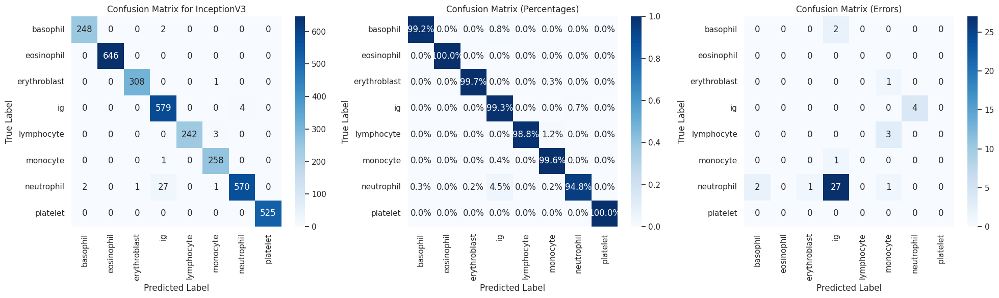

In [ ]:
inception_accuracy, y_true_inc, y_pred_inc = evaluate_model(model_inception, test_dataset_inception, "InceptionV3", class_names)
model_predictions["InceptionV3"] = y_pred_inc

In [ ]:
#clean_training_environment()

In [ ]:
print(f"Active TF graphs: {len(tf.compat.v1.get_default_graph().as_graph_def().node)} nodes")

Active TF graphs: 0 nodes


### 4.4 EffecientNet

In [ ]:
early_cb_effnet = keras.callbacks.EarlyStopping(
    patience=5,
    restore_best_weights=True,
    monitor="val_accuracy",
    min_delta=0.005
)

In [ ]:
# Prepare data for EfficientNetB3 input
train_dataset_effnet = train_dataset.map(lambda X, y: (preprocess_input_effnet(X), y)).prefetch(tf.data.AUTOTUNE)
val_dataset_effnet = val_dataset.map(lambda X, y: (preprocess_input_effnet(X), y)).prefetch(tf.data.AUTOTUNE)
test_dataset_effnet = test_dataset.map(lambda X, y: (preprocess_input_effnet(X), y)).prefetch(tf.data.AUTOTUNE)


In [ ]:
from tensorflow.keras.layers import Dropout

# EfficientNetB3 Model with Dropout
name = "Model_EfficientNetB3"
feature_extraction_layer_effnet = EfficientNetB3(include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
feature_extraction_layer_effnet.trainable = True

# Define the model
model_effnet = keras.Sequential([
    data_augmentation,
    feature_extraction_layer_effnet,
    layers.GlobalAvgPool2D(),
    Dropout(0.5),  # Add Dropout with high rate initially
    layers.Dense(8, activation="softmax")
], name=name)

# Compile the model
model_effnet.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
                     optimizer=keras.optimizers.Adam(learning_rate=0.0001),
                     metrics=["accuracy"])

# Define a callback to reduce the dropout rate
class ReduceDropoutCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        if epoch == 10:  # After 10 epochs, reduce the dropout rate
            self.model.layers[-2].rate = 0.2  # Reduce Dropout rate from 0.5 to 0.2
            print("\nReduced Dropout rate to 0.2")

# Instantiate the callback
reduce_dropout_callback = ReduceDropoutCallback()

# Train the model with the ReduceDropoutCallback
history_effnet = model_effnet.fit(train_dataset_effnet,
                                  validation_data=val_dataset_effnet,
                                  epochs=100,
                                  callbacks=[early_cb_effnet, reduce_dropout_callback],
                                  class_weight=class_weights)  # Added class_weight

# Log accuracy
train_accuracy_effnet = model_effnet.evaluate(train_dataset_effnet)[1]
val_accuracy_effnet = model_effnet.evaluate(val_dataset_effnet)[1]
lab_book[name] = {"train_accuracy": train_accuracy_effnet, "val_accuracy": val_accuracy_effnet}

# Extract loss values
effnet_loss = history_effnet.history['loss']
effnet_val_loss = history_effnet.history['val_loss']

model_metrics[name] = {
    'inference_time': measure_inference_time(model_effnet, test_dataset_effnet),
    'parameters': model_effnet.count_params(),
    'val_accuracy': max(history_effnet.history['val_accuracy'])
}

43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 306s 736ms/step - accuracy: 0.6928 - loss: 0.9043 - val_accuracy: 0.9505 - val_loss: 0.1468
Epoch 2/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 245s 715ms/step - accuracy: 0.9584 - loss: 0.1183 - val_accuracy: 0.9674 - val_loss: 0.0989
Epoch 3/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 245s 715ms/step - accuracy: 0.9740 - loss: 0.0693 - val_accuracy: 0.9824 - val_loss: 0.0553
Epoch 4/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 245s 716ms/step - accuracy: 0.9788 - loss: 0.0567 - val_accuracy: 0.9846 - val_loss: 0.0465
Epoch 5/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 244s 715ms/step - accuracy: 0.9828 - loss: 0.0430 - val_accuracy: 0.9864 - val_loss: 0.0426
Epoch 6/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 245s 716ms/step - accuracy: 0.9865 - loss: 0.0414 - val_accuracy: 0.9846 - val_loss: 0.0498
Epoch 7/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 245s 716ms/step - accuracy: 0.9884 - loss: 0.0321 - val_accuracy: 0.9853 - val_loss: 0.0453
Epoch 8/100
342/34

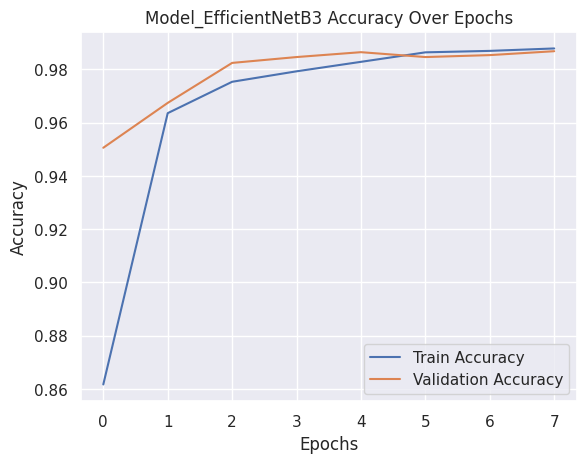

In [ ]:
# Plot training history
plot_training_history(history_effnet, name)

107/107 ━━━━━━━━━━━━━━━━━━━━ 16s 150ms/step - accuracy: 0.9799 - loss: 0.0566
107/107 ━━━━━━━━━━━━━━━━━━━━ 20s 160ms/step
Classification Report for EfficientNetB3:

              precision    recall  f1-score   support

    basophil       0.95      0.99      0.97       250
  eosinophil       1.00      1.00      1.00       646
erythroblast       1.00      0.97      0.98       309
          ig       0.95      0.97      0.96       583
  lymphocyte       0.98      0.97      0.98       245
    monocyte       0.95      0.98      0.97       259
  neutrophil       0.98      0.96      0.97       601
    platelet       1.00      1.00      1.00       525

    accuracy                           0.98      3418
   macro avg       0.98      0.98      0.98      3418
weighted avg       0.98      0.98      0.98      3418


Confidence Intervals (95%) for EfficientNetB3:
Accuracy: 0.9792 (0.9745 - 0.9842)
Macro Precision: 0.9717 - 0.9825
Macro Recall: 0.9745 - 0.9846
Weighted Precision: 0.9751 - 0.9844
We

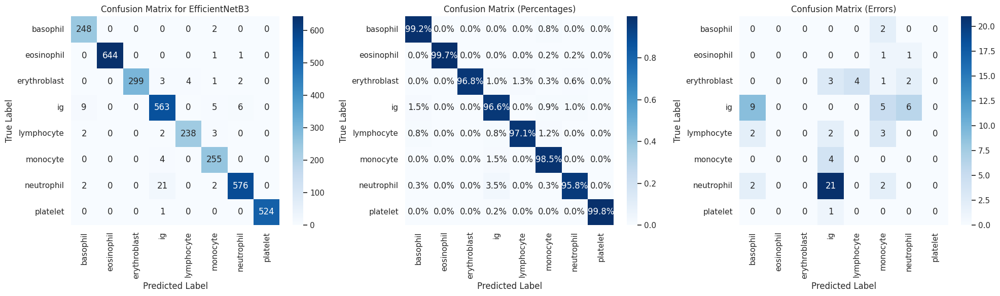

In [ ]:
# EfficientNetB3
effnet_accuracy, y_true_eff, y_pred_eff = evaluate_model(model_effnet, test_dataset_effnet, "EfficientNetB3", class_names)
model_predictions["EfficientNetB3"] = y_pred_eff

In [ ]:
clean_training_environment()

In [ ]:
print(f"Active TF graphs: {len(tf.compat.v1.get_default_graph().as_graph_def().node)} nodes")

Active TF graphs: 0 nodes


## 4.5 MobileNet

In [ ]:
early_cb_mobilenet = keras.callbacks.EarlyStopping(
    patience=5,
    restore_best_weights=True,
    monitor="val_accuracy",
    min_delta=0.005
)

In [ ]:
# Prepare data for MobileNet input
train_dataset_mobilenet = train_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)
val_dataset_mobilenet = val_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)
test_dataset_mobilenet = test_dataset.map(lambda X, y: (preprocess_input(X), y)).prefetch(tf.data.AUTOTUNE)

# Check format
for image_batch, labels_batch in train_dataset_mobilenet.take(1):
  print(f"Train data: {image_batch.shape}")
  print(f"Train labels: {labels_batch.shape}")

for image_batch, labels_batch in val_dataset_mobilenet.take(1):
  print(f"Validation data: {image_batch.shape}")
  print(f"Validation labels: {labels_batch.shape}")

for image_batch, labels_batch in test_dataset_mobilenet.take(1):
  print(f"Test data: {image_batch.shape}")
  print(f"Test labels: {labels_batch.shape}")

Train data: (32, 224, 224, 3)
Train labels: (32,)
Validation data: (32, 224, 224, 3)
Validation labels: (32,)
Test data: (32, 224, 224, 3)
Test labels: (32,)


In [ ]:
from tensorflow.keras.applications import MobileNetV3Large

In [ ]:
name = "Model_MobileNetV3"

feature_extraction_mobilenet = MobileNetV3Large(include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
feature_extraction_mobilenet.trainable = True
model_mobilenet = keras.Sequential([
    data_augmentation,
    feature_extraction_mobilenet,
    layers.GlobalAvgPool2D(),
    layers.Dropout(0.5),
    layers.Dense(8, activation="softmax")
], name=name)

model_mobilenet.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
                        optimizer=keras.optimizers.Adam(learning_rate=0.0001),
                        metrics=["accuracy"])

history_mobilenet = model_mobilenet.fit(train_dataset_mobilenet, validation_data=val_dataset_mobilenet,
                                        epochs=100, callbacks=[early_cb_mobilenet, reduce_dropout_callback],
                                        class_weight=class_weights)
model_metrics[name] = {
    'inference_time': measure_inference_time(model_mobilenet, test_dataset_mobilenet),
    'parameters': model_mobilenet.count_params(),
    'val_accuracy': max(history_mobilenet.history['val_accuracy'])
}

12683000/12683000 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 118s 265ms/step - accuracy: 0.6048 - loss: 1.1558 - val_accuracy: 0.8370 - val_loss: 0.5254
Epoch 2/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 89s 260ms/step - accuracy: 0.9522 - loss: 0.1375 - val_accuracy: 0.8711 - val_loss: 0.4222
Epoch 3/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 88s 258ms/step - accuracy: 0.9683 - loss: 0.0900 - val_accuracy: 0.9363 - val_loss: 0.1777
Epoch 4/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 88s 258ms/step - accuracy: 0.9792 - loss: 0.0620 - val_accuracy: 0.9454 - val_loss: 0.1467
Epoch 5/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 88s 258ms/step - accuracy: 0.9802 - loss: 0.0532 - val_accuracy: 0.9498 - val_loss: 0.1381
Epoch 6/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 89s 259ms/step - accuracy: 0.9860 - loss: 0.0387 - val_accuracy: 0.9714 - val_loss: 0.0881
Epoch 7/100
342/342 ━━━━━━━━━━━━━━━━━━━━ 89s 259ms/step - accuracy: 0.9840 - loss: 0.0381 - val_accuracy: 0.9813 - val_loss: 0.0582
Epoch 8/100
342/342 ━━━━

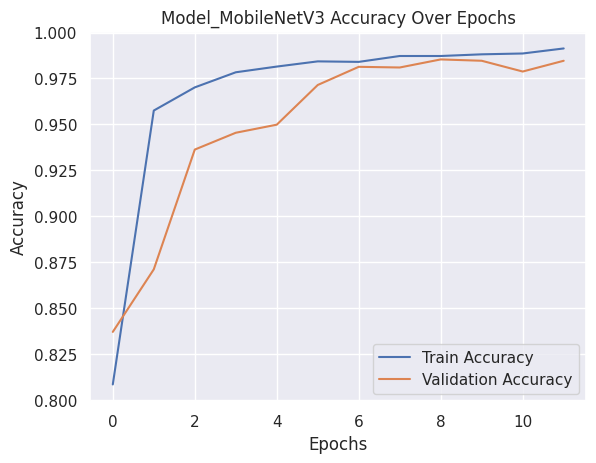

In [ ]:
plot_training_history(history_mobilenet, name)

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - accuracy: 0.9840 - loss: 0.0465
107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step
Classification Report for MobileNetV3:

              precision    recall  f1-score   support

    basophil       0.97      1.00      0.98       250
  eosinophil       1.00      1.00      1.00       646
erythroblast       1.00      0.99      0.99       309
          ig       0.94      0.98      0.96       583
  lymphocyte       0.99      1.00      0.99       245
    monocyte       1.00      0.89      0.94       259
  neutrophil       0.98      0.98      0.98       601
    platelet       1.00      1.00      1.00       525

    accuracy                           0.98      3418
   macro avg       0.98      0.98      0.98      3418
weighted avg       0.98      0.98      0.98      3418


Confidence Intervals (95%) for MobileNetV3:
Accuracy: 0.9830 (0.9786 - 0.9877)
Macro Precision: 0.9807 - 0.9891
Macro Recall: 0.9732 - 0.9842
Weighted Precision: 0.9794 - 0.9879
Weighted Rec

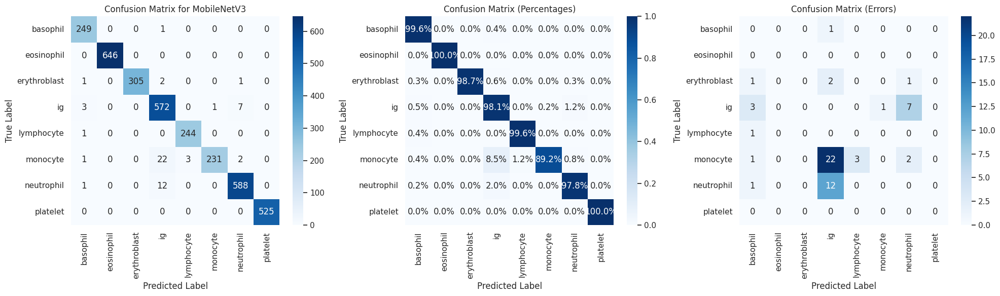

In [ ]:
mobilenet_accuracy, y_true_mob, y_pred_mob = evaluate_model(model_mobilenet, test_dataset_mobilenet, "MobileNetV3", class_names)
model_predictions["MobileNetV3"] = y_pred_mob

In [ ]:
clean_training_environment()

## 4.6 Swin Transformer V2

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, models
import timm  # For using pre-trained Swin Transformer models
import pandas as pd
import numpy as np
from PIL import Image
import os
import gc
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, classification_report

In [ ]:
class TorchDatasetAdapter(Dataset):
    def __init__(self, tf_dataset, img_size=224):
        self.images = []
        self.labels = []
        for img, lbl in tf_dataset.unbatch():
            resized_img = tf.image.resize(img, [img_size, img_size]).numpy()
            self.images.append(resized_img.transpose(2, 0, 1))  # CHW format
            self.labels.append(lbl.numpy())

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return (torch.tensor(self.images[idx], dtype=torch.float32),
                torch.tensor(self.labels[idx], dtype=torch.long))

class EarlyStopping:
    def __init__(self, patience=3, min_delta=0.005):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_metric = -np.inf
        self.best_model_weights = None
        self.early_stop = False

    def __call__(self, current_metric, model):
        if current_metric > self.best_metric + self.min_delta:
            self.best_metric = current_metric
            self.counter = 0
            self.best_model_weights = model.state_dict().copy()
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
                print(f"\nEarly stopping triggered after {self.patience} epochs without improvement")


In [ ]:
# Swin Training and Evaluation
def swin_transformer_workflow():

    global model

    torch.cuda.empty_cache()
    gc.collect()

    # Convert datasets
    IMG_SIZE = 224
    BATCH_SIZE = 16
    train_pt = TorchDatasetAdapter(train_dataset, IMG_SIZE)
    val_pt = TorchDatasetAdapter(val_dataset, IMG_SIZE)
    test_pt = TorchDatasetAdapter(test_dataset, IMG_SIZE)

    train_loader = DataLoader(train_pt,
                              batch_size=BATCH_SIZE,
                              shuffle=True,
                              num_workers=2,
                              generator=torch.Generator().manual_seed(SEED),
                              pin_memory=True,
                              persistent_workers=True)

    val_loader = DataLoader(val_pt, batch_size=BATCH_SIZE, num_workers=2)
    test_loader = DataLoader(test_pt, batch_size=BATCH_SIZE, num_workers=2)

    # Model setup
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = timm.create_model('swin_tiny_patch4_window7_224',
                                pretrained=True,
                                num_classes=8,
                                drop_rate=0.3,  # Increased regularization
                                drop_path_rate=0.2).to(device)

    # Convert class weights to PyTorch format
    class_weights_tensor = torch.tensor([class_weights[i] for i in sorted(class_weights.keys())],
                                      dtype=torch.float16).to(device)

    # Training setup
    criterion = nn.CrossEntropyLoss(weight=class_weights_tensor)
    optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=1e-4)
    scaler = torch.cuda.amp.GradScaler()
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=2, factor=0.5)
    early_stopper = EarlyStopping(patience=3, min_delta=0.005)

    # Add this before training loop
    model.set_grad_checkpointing(enable=True)  # Saves ~40% memory

    # Training loop
    train_loss_hist, train_acc_hist = [], []
    val_loss_hist, val_acc_hist = [], []

    for epoch in range(100):
        torch.cuda.empty_cache()

        # Train
        model.train()
        train_loss, train_acc = 0.0, 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            with torch.cuda.amp.autocast(dtype=torch.float16):
                outputs = model(inputs)
                loss = criterion(outputs, labels)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            train_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            train_acc += (predicted == labels).sum().item()/labels.size(0)


        # Validate
        model.eval()
        val_loss, val_acc = 0.0, 0.0
        with torch.no_grad(), torch.cuda.amp.autocast():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                val_loss += criterion(outputs, labels).item()
                _, predicted = torch.max(outputs, 1)
                val_acc += (predicted == labels).sum().item()/labels.size(0)

        # Update metrics
        train_loss /= len(train_loader)
        train_acc /= len(train_loader)
        val_loss /= len(val_loader)
        val_acc /= len(val_loader)

        # Update histories
        train_loss_hist.append(train_loss)
        train_acc_hist.append(train_acc)
        val_loss_hist.append(val_loss)
        val_acc_hist.append(val_acc)

        # Early stopping check
        early_stopper(val_acc, model)
        if early_stopper.early_stop:
            print("Restoring best weights")
            model.load_state_dict(early_stopper.best_model_weights)
            break

        print(f"Epoch {epoch+1}")
        print(f"Train Loss: {train_loss:.4f} | Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Acc: {val_acc:.4f}\n")


    # --- Inference Timing ---
    model.eval()
    timings = []

    # Warm-up
    with torch.no_grad():
        dummy_input = torch.randn(1, 3, IMG_SIZE, IMG_SIZE).to(device)
        for _ in range(10):
            _ = model(dummy_input)
        if device.type == 'cuda':
            torch.cuda.synchronize()

    # Measurement
    with torch.no_grad():
        for inputs, _ in test_loader:
            start_time = time.perf_counter()
            _ = model(inputs.to(device))
            if device.type == 'cuda':
                torch.cuda.synchronize()
            timings.append(time.perf_counter() - start_time)

    # Calculate average per-sample time in ms
    avg_time = (np.mean(timings) / inputs.size(0)) * 1000

    # Final evaluation
    model.eval()
    y_true, y_pred = [], []
    with torch.no_grad():
        for inputs, labels in test_loader:
            outputs = model(inputs.to(device))
            _, predicted = torch.max(outputs, 1)
            y_true.extend(labels.numpy())
            y_pred.extend(predicted.cpu().numpy())

    # Compute test accuracy
    test_accuracy = accuracy_score(y_true, y_pred)  # THIS IS THE CRUCIAL FIX

    # Generate reports
    print(f'\nClassification Report for Swin Transformer:\n')
    print(classification_report(y_true, y_pred, target_names=class_names))

    # Compute confidence intervals
    ci = compute_metrics_with_ci(np.array(y_true), np.array(y_pred))

    # Print CIs using properly computed accuracy
    print("\nConfidence Intervals (95%) for Swin Transformer:")
    print(f"Accuracy: {test_accuracy:.4f} ({ci['accuracy'][0]:.4f} - {ci['accuracy'][1]:.4f})")
    print(f"Macro Precision: {ci['precision_macro'][0]:.4f} - {ci['precision_macro'][1]:.4f}")
    print(f"Macro Recall: {ci['recall_macro'][0]:.4f} - {ci['recall_macro'][1]:.4f}")
    print(f"Weighted Precision: {ci['precision_weighted'][0]:.4f} - {ci['precision_weighted'][1]:.4f}")
    print(f"Weighted Recall: {ci['recall_weighted'][0]:.4f} - {ci['recall_weighted'][1]:.4f}")

    # Plot confusion matrices
    cm = confusion_matrix(y_true, y_pred)
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[0])
    axes[0].set_title('Confusion Matrix (Absolute)')

    cm_percent = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    sns.heatmap(cm_percent, annot=True, fmt='.1%', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[1])
    axes[1].set_title('Confusion Matrix (%)')

    error_mask = np.array(y_true) != np.array(y_pred)
    cm_errors = confusion_matrix(y_true, y_pred, sample_weight=error_mask.astype(int))
    sns.heatmap(cm_errors, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names, ax=axes[2])
    plt.suptitle('Swin Transformer - Confusion Matrices')
    plt.show()

    # Plot training history
    plt.figure(figsize=(12,4))
    plt.subplot(121)
    plt.plot(train_acc_hist, label='Train')
    plt.plot(val_acc_hist, label='Validation')
    plt.title('Accuracy History')
    plt.legend()

    plt.subplot(122)
    plt.plot(train_loss_hist, label='Train')
    plt.plot(val_loss_hist, label='Validation')
    plt.title('Loss History')
    plt.legend()
    plt.suptitle('Swin Transformer Training Metrics')
    plt.show()

    return {
        'train_loss': train_loss_hist,
        'val_loss': val_loss_hist,
        'train_acc': train_acc_hist,
        'val_acc': val_acc_hist,
        'inference_time': avg_time,
        'parameters': sum(p.numel() for p in model.parameters()),
        'test_accuracy': test_accuracy,
        'y_true': y_true,
        'y_pred': y_pred
    }

model.safetensors:   0%|          | 0.00/114M [00:00<?, ?B/s]

<ipython-input-57-214855fd7bd5>:42: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler()
<ipython-input-57-214855fd7bd5>:63: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(dtype=torch.float16):
/usr/local/lib/python3.10/dist-packages/torch/_dynamo/eval_frame.py:632: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.5 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  return fn(*args, **kwargs)
<ipython-input-57-214855fd7bd5>:79: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `

Epoch 1
Train Loss: 0.5718 | Acc: 0.8027
Val Loss: 0.0964 | Acc: 0.9694

Epoch 2
Train Loss: 0.1433 | Acc: 0.9539
Val Loss: 0.0489 | Acc: 0.9841

Epoch 3
Train Loss: 0.0876 | Acc: 0.9702
Val Loss: 0.0531 | Acc: 0.9864

Epoch 4
Train Loss: 0.0540 | Acc: 0.9824
Val Loss: 0.0672 | Acc: 0.9786


Early stopping triggered after 3 epochs without improvement
Restoring best weights

Classification Report for Swin Transformer:

              precision    recall  f1-score   support

    basophil       1.00      1.00      1.00       250
  eosinophil       1.00      1.00      1.00       646
erythroblast       0.99      0.99      0.99       309
          ig       0.97      0.97      0.97       583
  lymphocyte       0.98      0.99      0.99       245
    monocyte       0.99      0.98      0.99       259
  neutrophil       0.98      0.97      0.97       601
    platelet       1.00      1.00      1.00       525

    accuracy                           0.99      3418
   macro avg       0.99      0.99   

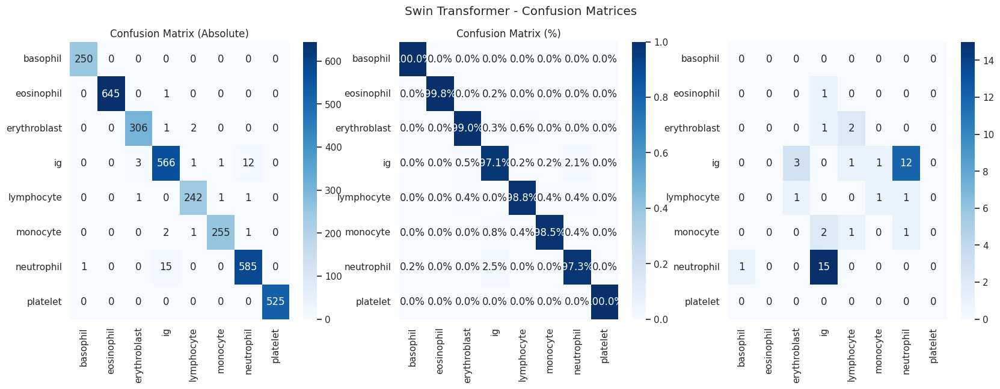

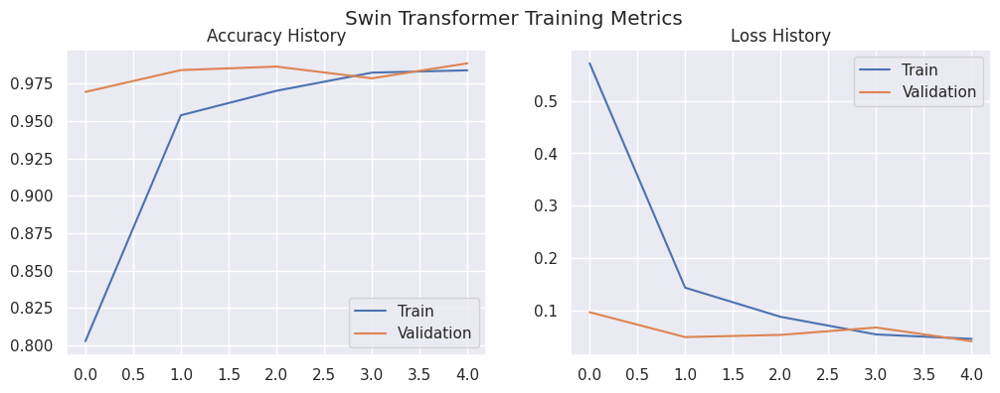

In [ ]:
# Run Swin workflow and capture all metrics
swin_metrics = swin_transformer_workflow()

In [ ]:
# Access individual metrics from the dictionary
swin_val_acc = swin_metrics['val_acc']
swin_val_loss = swin_metrics['val_loss']
swin_test_acc = swin_metrics['test_accuracy']

In [ ]:
# Add Swin to model_metrics (AFTER ALL OTHER MODELS)
model_metrics['SwinTransformer'] = {
    'inference_time': swin_metrics['inference_time'],
    'parameters': swin_metrics['parameters'],
    'val_accuracy': max(swin_metrics['val_acc'])  # Extract max validation accuracy
}

In [ ]:
model_predictions["Swin Transformer"] = np.array(swin_metrics['y_pred'])
y_true_swin = np.array(swin_metrics['y_true'])

In [ ]:
'''# Verify alignment with other models' y_true (e.g., from a Keras model)
assert np.array_equal(y_true_cnn, y_true_swin), "Mismatch in y_true between Swin and other models"'''

'# Verify alignment with other models\' y_true (e.g., from a Keras model)\nassert np.array_equal(y_true_cnn, y_true_swin), "Mismatch in y_true between Swin and other models"'

## 5. Statistical Analysis

In [ ]:
# Verify y_true alignment (use one of the TF model's y_true)
y_true = y_true_cnn

# Ensure Swin's y_true matches
assert len(y_true) == len(swin_metrics['y_true']), "Swin y_true length mismatch"
assert all(y_true == swin_metrics['y_true']), "Swin y_true value mismatch"

# Pairwise McNemar's Tests with Statsmodels
from statsmodels.stats.contingency_tables import mcnemar

print("Statistical Significance of Model Differences (McNemar's Test)")
print("------------------------------------------------------------")
model_names = list(model_predictions.keys())
for i in range(len(model_names)):
    for j in range(i+1, len(model_names)):
        model_a = model_names[i]
        model_b = model_names[j]

        pred_a = model_predictions[model_a]
        pred_b = model_predictions[model_b]

        # Build contingency matrix
        both_correct = np.sum((pred_a == y_true) & (pred_b == y_true))
        a_correct_b_wrong = np.sum((pred_a == y_true) & (pred_b != y_true))
        a_wrong_b_correct = np.sum((pred_a != y_true) & (pred_b == y_true))
        both_wrong = np.sum((pred_a != y_true) & (pred_b != y_true))

        table = [[a_correct_b_wrong, a_wrong_b_correct],
                 [both_wrong, both_correct]]  # Focus on discordant pairs

        # Run test (exact=FALSE uses chi-sq approximation)
        result = mcnemar(table, exact=False)

        # Interpret results
        if result.pvalue < 0.05:
            conclusion = "Significant difference"
        else:
            conclusion = "No significant difference"

        print(f"{model_a} vs {model_b}: p = {result.pvalue:.4f} ({conclusion})")

Statistical Significance of Model Differences (McNemar's Test)
------------------------------------------------------------
Custom CNN vs ResNet50: p = 0.0000 (Significant difference)
Custom CNN vs InceptionV3: p = 0.0000 (Significant difference)
Custom CNN vs EfficientNetB3: p = 0.0000 (Significant difference)
Custom CNN vs MobileNetV3: p = 0.0000 (Significant difference)
Custom CNN vs Swin Transformer: p = 0.0000 (Significant difference)
ResNet50 vs InceptionV3: p = 0.2684 (No significant difference)
ResNet50 vs EfficientNetB3: p = 0.8744 (No significant difference)
ResNet50 vs MobileNetV3: p = 0.1547 (No significant difference)
ResNet50 vs Swin Transformer: p = 0.6353 (No significant difference)
InceptionV3 vs EfficientNetB3: p = 0.8774 (No significant difference)
InceptionV3 vs MobileNetV3: p = 0.0449 (Significant difference)
InceptionV3 vs Swin Transformer: p = 0.4404 (No significant difference)
EfficientNetB3 vs MobileNetV3: p = 0.0090 (Significant difference)
EfficientNetB3 vs S

In [ ]:
import numpy as np
from scipy.stats import chi2

def cochrans_q_test(binary_matrix):
    """
    Perform Cochran's Q test for comparing multiple classifiers.

    Args:
        binary_matrix : ndarray, shape (n_samples, n_models)
            1 if correct prediction, 0 otherwise for each sample and model.

    Returns:
        Q : float, Cochran's Q statistic
        p_value : float, p-value from chi-squared distribution
    """
    n_samples, n_models = binary_matrix.shape

    # Sum correct per model (Lj) and per sample (Gi)
    Lj = binary_matrix.sum(axis=0)
    Gi = binary_matrix.sum(axis=1)

    # Compute Q statistic
    numerator = (n_models - 1) * (n_models * np.sum(Lj**2) - (np.sum(Lj))**2)
    denominator = n_models * np.sum(Gi) - np.sum(Gi**2)

    # Avoid division by zero (if all predictions agree)
    if denominator == 0:
        return 0.0, 1.0  # Q=0, p=1

    Q = numerator / denominator
    df = n_models - 1
    p_value = 1 - chi2.cdf(Q, df)

    return Q, p_value

# Prepare binary correctness matrix: rows=samples, columns=models
binary_correct = np.column_stack([
    (pred == y_true).astype(int)
    for pred in model_predictions.values()
])

# Run Cochran's Q test
Q, p_value = cochrans_q_test(binary_correct)
print(f"Cochran's Q Test:\nQ = {Q:.2f}, p = {p_value:.6f}")


Cochran's Q Test:
Q = 648.62, p = 0.000000


## 6. Test all models on the test set

In [ ]:
# Store validation accuracies
history_custom_val_acc = history_custom.history['val_accuracy']
history_res_val_acc = history_resnet.history['val_accuracy']
history_effnet_val_acc = history_effnet.history['val_accuracy']
history_inception_val_acc = history_inception.history['val_accuracy']
history_mobilenet_val_acc = history_mobilenet.history['val_accuracy']
history_swin_val_acc = swin_metrics['val_acc']  # Access from metrics dict

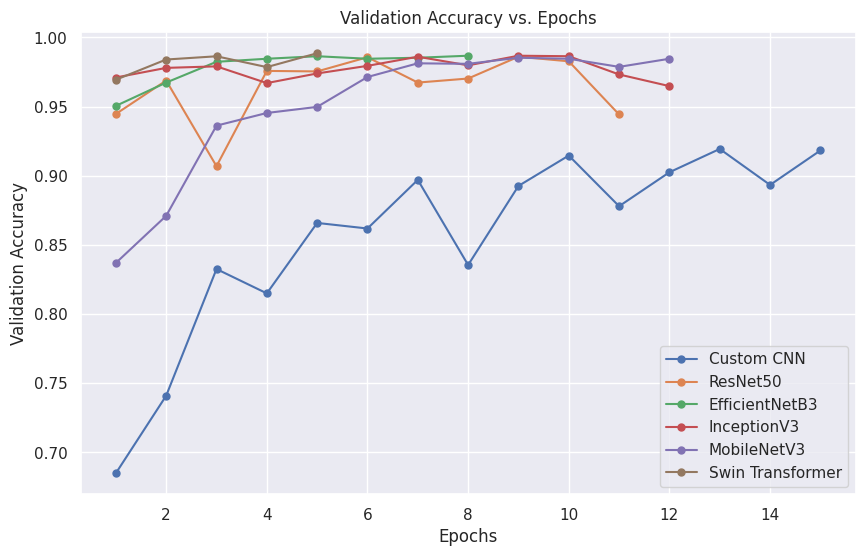

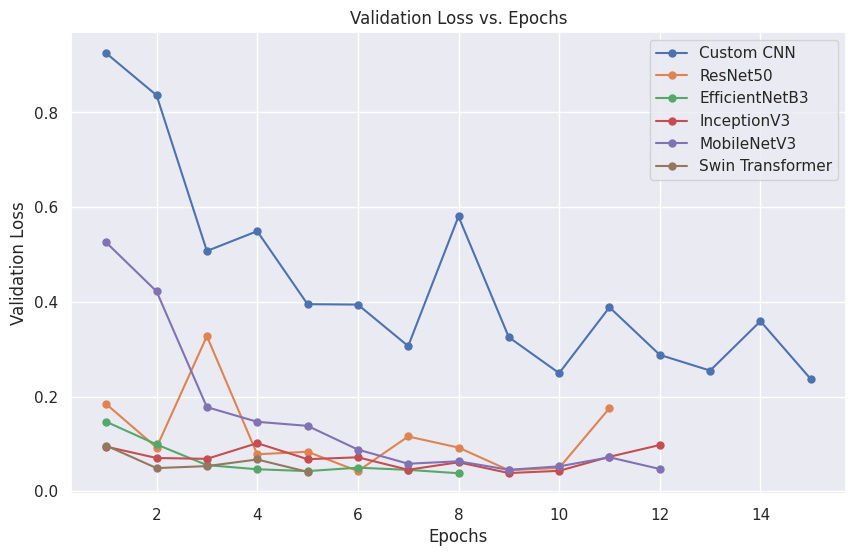


Final Test Accuracies:
- Custom CNN: 0.9184
- ResNet50: 0.9883
- EfficientNetB3: 0.9792
- InceptionV3: 0.9877
- MobileNetV3: 0.9830
- Swin Transformer: 0.9871


In [ ]:
# Validation Accuracy Comparison
plt.figure(figsize=(10, 6))

# Existing models (keep original format)
plt.plot(range(1, len(history_custom_val_acc) + 1), history_custom_val_acc,
         label='Custom CNN', marker='o', markersize=5)
plt.plot(range(1, len(history_res_val_acc) + 1), history_res_val_acc,
         label='ResNet50', marker='o', markersize=5)
plt.plot(range(1, len(history_effnet_val_acc) + 1), history_effnet_val_acc,
         label='EfficientNetB3', marker='o', markersize=5)
plt.plot(range(1, len(history_inception_val_acc) + 1), history_inception_val_acc,
         label='InceptionV3', marker='o', markersize=5)
plt.plot(range(1, len(history_mobilenet_val_acc) + 1), history_mobilenet_val_acc,
         label='MobileNetV3', marker='o', markersize=5)

# Add Swin Transformer with matching style
plt.plot(range(1, len(swin_val_acc) + 1), swin_val_acc,
         label='Swin Transformer', marker='o', markersize=5)

plt.title('Validation Accuracy vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Validation Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# Validation Loss Comparison
plt.figure(figsize=(10, 6))

plt.plot(range(1, len(history_custom.history['val_loss']) + 1),
         history_custom.history['val_loss'], label='Custom CNN', marker='o', markersize=5)
plt.plot(range(1, len(history_resnet.history['val_loss']) + 1),
         history_resnet.history['val_loss'], label='ResNet50', marker='o', markersize=5)
plt.plot(range(1, len(history_effnet.history['val_loss']) + 1),
         history_effnet.history['val_loss'], label='EfficientNetB3', marker='o', markersize=5)
plt.plot(range(1, len(history_inception.history['val_loss']) + 1),
         history_inception.history['val_loss'], label='InceptionV3', marker='o', markersize=5)
plt.plot(range(1, len(history_mobilenet.history['val_loss']) + 1),
         history_mobilenet.history['val_loss'], label='MobileNetV3', marker='o', markersize=5)
plt.plot(range(1, len(swin_val_loss) + 1), swin_val_loss,
         label='Swin Transformer', marker='o', markersize=5)

plt.title('Validation Loss vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# Print all test accuracies
print("\nFinal Test Accuracies:")
print(f"- Custom CNN: {model_custom.evaluate(test_dataset, verbose=0)[1]:.4f}")
print(f"- ResNet50: {model_resnet.evaluate(test_dataset_resnet, verbose=0)[1]:.4f}")
print(f"- EfficientNetB3: {model_effnet.evaluate(test_dataset_effnet, verbose=0)[1]:.4f}")
print(f"- InceptionV3: {model_inception.evaluate(test_dataset_inception, verbose=0)[1]:.4f}")
print(f"- MobileNetV3: {model_mobilenet.evaluate(test_dataset_mobilenet, verbose=0)[1]:.4f}")
print(f"- Swin Transformer: {swin_test_acc:.4f}")

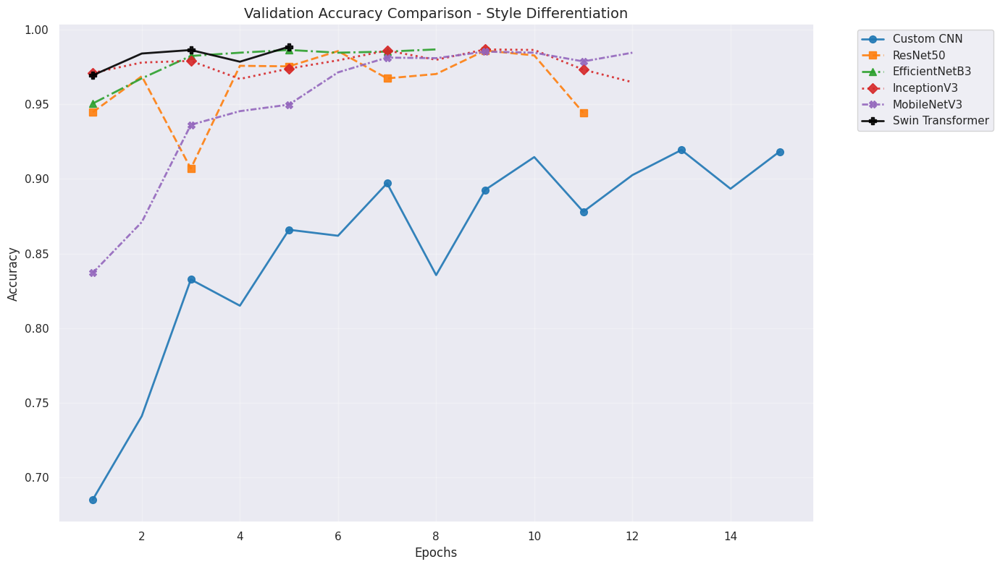

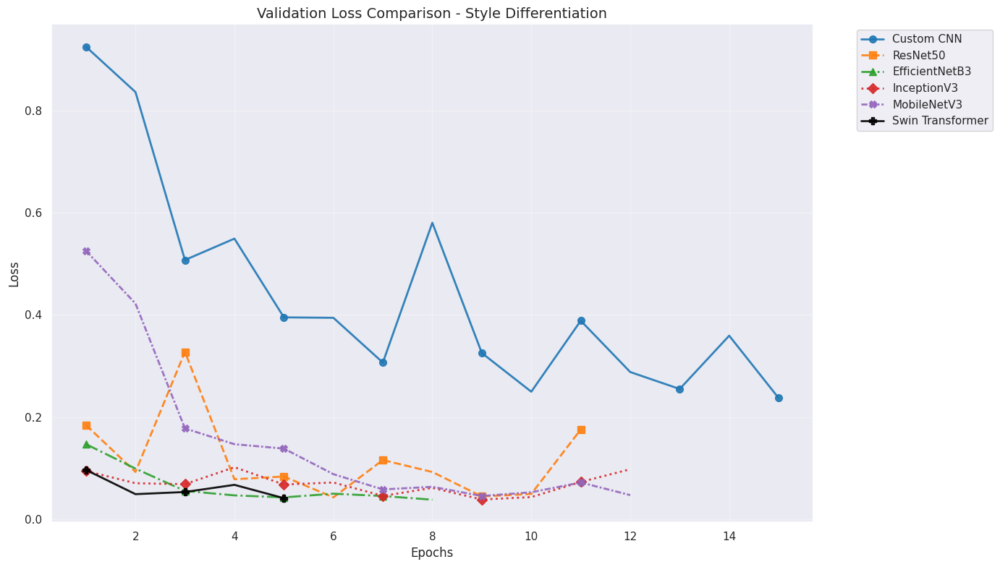

In [ ]:
def option1_plots():
    # Accuracy Plot
    plt.figure(figsize=(14, 8))
    style_config = {
        'Custom CNN':        ('#1f77b4', 'o', '-'),
        'ResNet50':          ('#ff7f0e', 's', '--'),
        'EfficientNetB3':    ('#2ca02c', '^', '-.'),
        'InceptionV3':       ('#d62728', 'D', ':'),
        'MobileNetV3':       ('#9467bd', 'X', (0, (3, 1, 1, 1))),
        'Swin Transformer':  ('#000000', 'P', '-')
    }

    for name, data in [
        ('Custom CNN', history_custom_val_acc),
        ('ResNet50', history_res_val_acc),
        ('EfficientNetB3', history_effnet_val_acc),
        ('InceptionV3', history_inception_val_acc),
        ('MobileNetV3', history_mobilenet_val_acc),
        ('Swin Transformer', swin_val_acc)
    ]:
        color, marker, linestyle = style_config[name]
        plt.plot(range(1, len(data)+1), data,
                 label=name, color=color, marker=marker,
                 linestyle=linestyle, markersize=7,
                 markevery=2, alpha=0.9, linewidth=2)

    plt.title('Validation Accuracy Comparison - Style Differentiation', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Accuracy', fontsize=12)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    # Loss Plot
    plt.figure(figsize=(14, 8))
    for name, data in [
        ('Custom CNN', history_custom.history['val_loss']),
        ('ResNet50', history_resnet.history['val_loss']),
        ('EfficientNetB3', history_effnet.history['val_loss']),
        ('InceptionV3', history_inception.history['val_loss']),
        ('MobileNetV3', history_mobilenet.history['val_loss']),
        ('Swin Transformer', swin_val_loss)
    ]:
        color, marker, linestyle = style_config[name]
        plt.plot(range(1, len(data)+1), data,
                 label=name, color=color, marker=marker,
                 linestyle=linestyle, markersize=7,
                 markevery=2, alpha=0.9, linewidth=2)

    plt.title('Validation Loss Comparison - Style Differentiation', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

option1_plots()

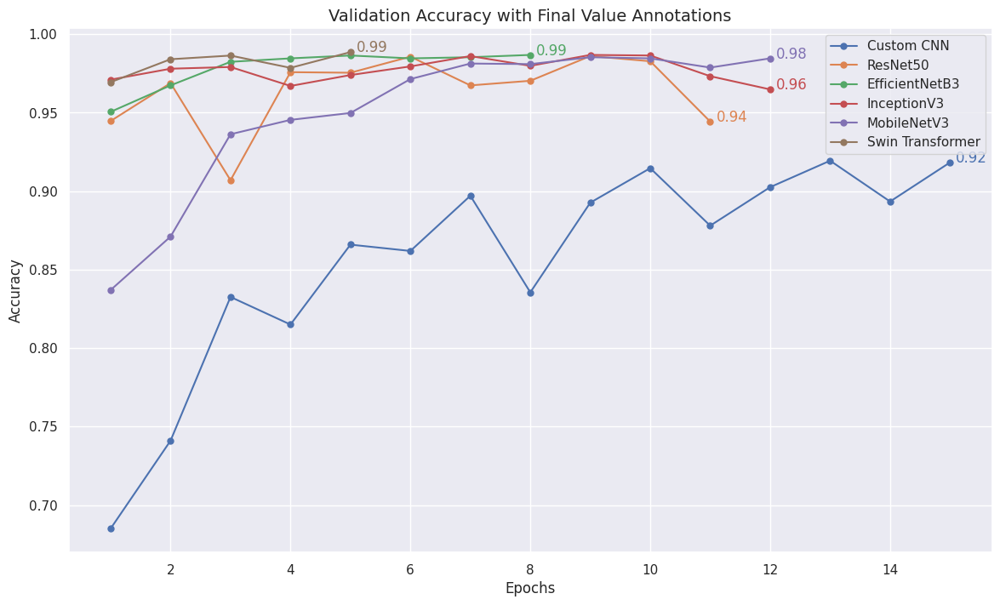

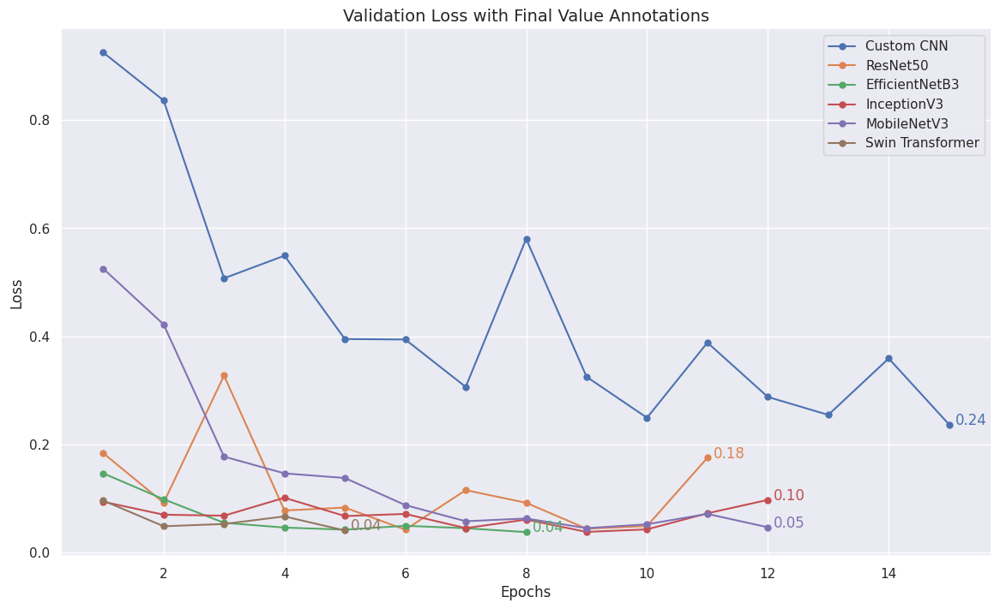

In [ ]:
def option2_plots():
    # Accuracy Plot
    plt.figure(figsize=(14, 8))
    for name, data in [
        ('Custom CNN', history_custom_val_acc),
        ('ResNet50', history_res_val_acc),
        ('EfficientNetB3', history_effnet_val_acc),
        ('InceptionV3', history_inception_val_acc),
        ('MobileNetV3', history_mobilenet_val_acc),
        ('Swin Transformer', swin_val_acc)
    ]:
        line, = plt.plot(range(1, len(data)+1), data, label=name, marker='o', markersize=5)
        final_val = data[-1]
        plt.annotate(f'{final_val:.2f}',
                    (len(data), final_val),
                    textcoords="offset points",
                    xytext=(5,0),
                    ha='left',
                    color=line.get_color())

    plt.title('Validation Accuracy with Final Value Annotations', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Accuracy', fontsize=12)
    plt.legend()
    plt.grid(True)
    plt.show()

    # Loss Plot
    plt.figure(figsize=(14, 8))
    for name, data in [
        ('Custom CNN', history_custom.history['val_loss']),
        ('ResNet50', history_resnet.history['val_loss']),
        ('EfficientNetB3', history_effnet.history['val_loss']),
        ('InceptionV3', history_inception.history['val_loss']),
        ('MobileNetV3', history_mobilenet.history['val_loss']),
        ('Swin Transformer', swin_val_loss)
    ]:
        line, = plt.plot(range(1, len(data)+1), data, label=name, marker='o', markersize=5)
        final_val = data[-1]
        plt.annotate(f'{final_val:.2f}',
                    (len(data), final_val),
                    textcoords="offset points",
                    xytext=(5,0),
                    ha='left',
                    color=line.get_color())

    plt.title('Validation Loss with Final Value Annotations', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.legend()
    plt.grid(True)
    plt.show()

option2_plots()

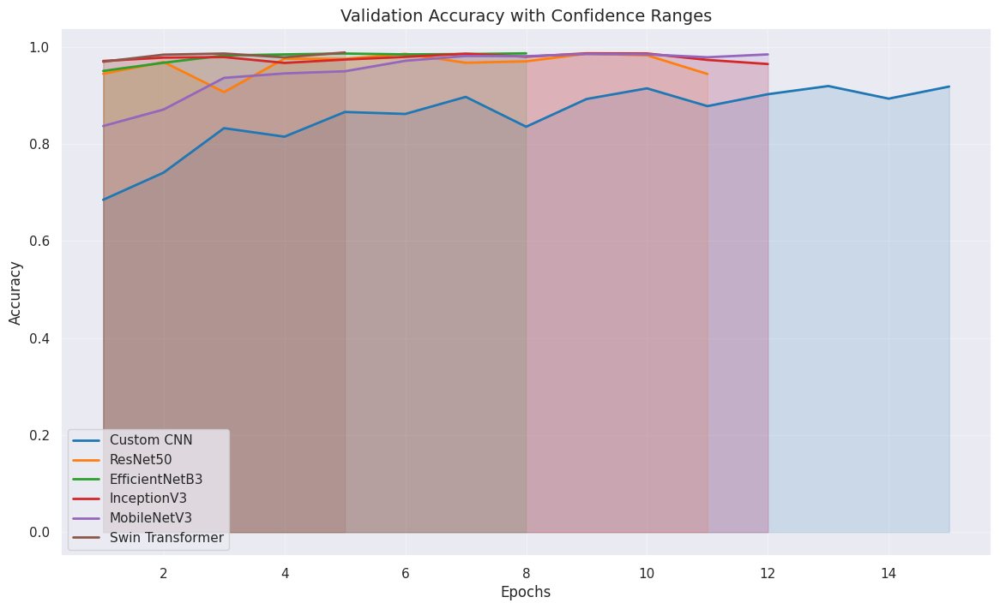

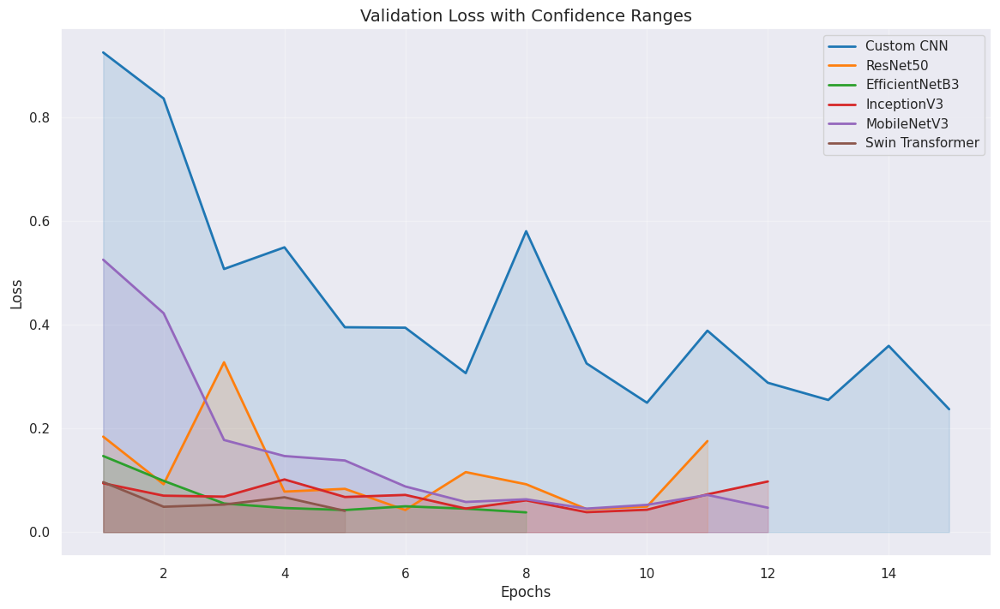

In [ ]:
def option3_plots():
    cmap = plt.get_cmap('tab10')

    # Accuracy Plot
    plt.figure(figsize=(14, 8))
    for idx, (name, data) in enumerate([
        ('Custom CNN', history_custom_val_acc),
        ('ResNet50', history_res_val_acc),
        ('EfficientNetB3', history_effnet_val_acc),
        ('InceptionV3', history_inception_val_acc),
        ('MobileNetV3', history_mobilenet_val_acc),
        ('Swin Transformer', swin_val_acc)
    ]):
        color = cmap(idx)
        plt.fill_between(range(1, len(data)+1), data, alpha=0.15, color=color)
        plt.plot(range(1, len(data)+1), data, label=name, color=color, linewidth=2)

    plt.title('Validation Accuracy with Confidence Ranges', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Accuracy', fontsize=12)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    # Loss Plot
    plt.figure(figsize=(14, 8))
    for idx, (name, data) in enumerate([
        ('Custom CNN', history_custom.history['val_loss']),
        ('ResNet50', history_resnet.history['val_loss']),
        ('EfficientNetB3', history_effnet.history['val_loss']),
        ('InceptionV3', history_inception.history['val_loss']),
        ('MobileNetV3', history_mobilenet.history['val_loss']),
        ('Swin Transformer', swin_val_loss)
    ]):
        color = cmap(idx)
        plt.fill_between(range(1, len(data)+1), data, alpha=0.15, color=color)
        plt.plot(range(1, len(data)+1), data, label=name, color=color, linewidth=2)

    plt.title('Validation Loss with Confidence Ranges', fontsize=14)
    plt.xlabel('Epochs', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

option3_plots()

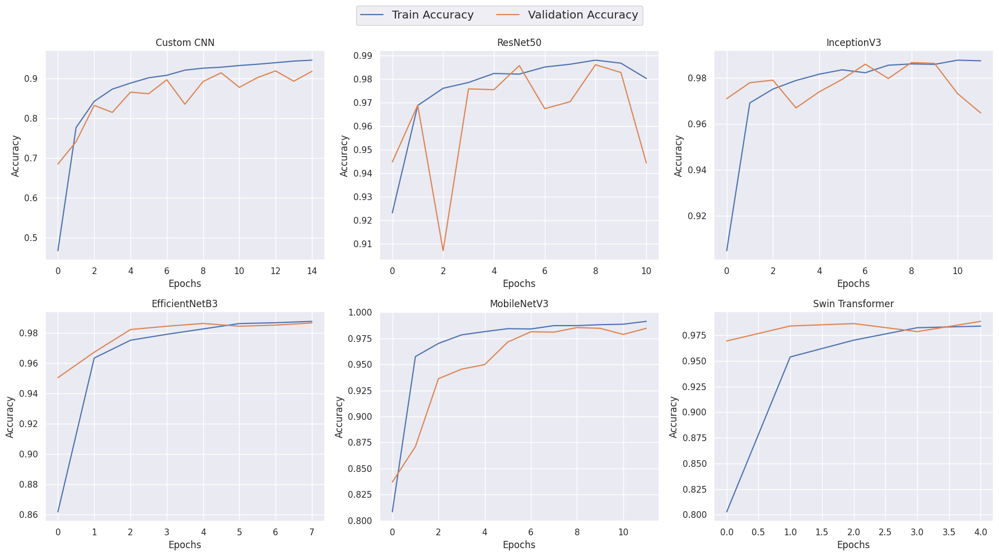

In [ ]:
import matplotlib.pyplot as plt

# Define the histories
histories = {
    'Custom CNN': history_custom,
    'ResNet50': history_resnet,
    'InceptionV3': history_inception,
    'EfficientNetB3': history_effnet,
    'MobileNetV3': history_mobilenet,
    'Swin Transformer': swin_metrics
}

# Create a figure with 2 rows and 3 columns
fig, axs = plt.subplots(2, 3, figsize=(18, 10))  # Adjusted height to accommodate legend

# Define the indices for the subplot
indices = [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2)]

# Plot each model's history (omit individual legends)
for (row, col), (model_name, history) in zip(indices, histories.items()):
    if model_name == 'Swin Transformer':
        axs[row, col].plot(swin_metrics['train_acc'], label='Train Accuracy')
        axs[row, col].plot(swin_metrics['val_acc'], label='Validation Accuracy')
    else:
        axs[row, col].plot(history.history['accuracy'], label='Train Accuracy')
        axs[row, col].plot(history.history['val_accuracy'], label='Validation Accuracy')
    axs[row, col].set_title(model_name)
    axs[row, col].set_xlabel('Epochs')
    axs[row, col].set_ylabel('Accuracy')

# Get handles and labels from the first subplot
handles, labels = axs[0,0].get_legend_handles_labels()

# Create a single legend above all subplots
fig.legend(handles, labels,
           loc='upper center',
           bbox_to_anchor=(0.5, 1.0),  # Positions legend at the top
           ncol=2,  # Two columns for compact layout
           fontsize='large')  # Optional: Adjust font size

# Adjust layout to make space for the legend
fig.tight_layout(rect=[0, 0, 1, 0.95])  # Leaves 5% space at the top

plt.show()


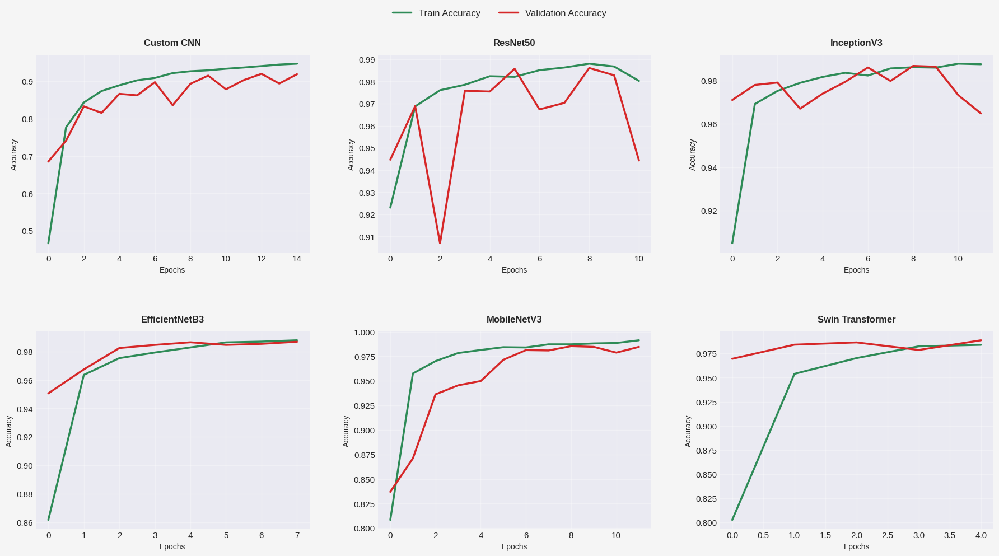

In [ ]:
import matplotlib.pyplot as plt

# Define custom colors
TRAIN_COLOR = '#2E8B57'  # Sea green for training
VAL_COLOR = '#D62728'    # Slate blue for validation

# Define the histories
histories = {
    'Custom CNN': history_custom,
    'ResNet50': history_resnet,
    'InceptionV3': history_inception,
    'EfficientNetB3': history_effnet,
    'MobileNetV3': history_mobilenet,
    'Swin Transformer': swin_metrics
}

# Create a figure with 2 rows and 3 columns
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
fig.patch.set_facecolor('#f5f5f5')  # Light gray background

# Define the indices for the subplot
indices = [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2)]

# Plot each model's history with new colors and bold titles
for (row, col), (model_name, history) in zip(indices, histories.items()):
    ax = axs[row, col]

    if model_name == 'Swin Transformer':
        ax.plot(swin_metrics['train_acc'], color=TRAIN_COLOR,
               linewidth=2.5, label='Train Accuracy')
        ax.plot(swin_metrics['val_acc'], color=VAL_COLOR,
               linewidth=2.5, label='Validation Accuracy')
    else:
        ax.plot(history.history['accuracy'], color=TRAIN_COLOR,
               linewidth=2.5, label='Train Accuracy')
        ax.plot(history.history['val_accuracy'], color=VAL_COLOR,
               linewidth=2.5, label='Validation Accuracy')

    # Formatting with bold title
    ax.set_title(model_name, fontweight='bold', fontsize=12, pad=12)
    ax.set_xlabel('Epochs', fontsize=10)
    ax.set_ylabel('Accuracy', fontsize=10)
    ax.grid(True, alpha=0.3)

# Get handles and labels from the first subplot
handles, labels = axs[0,0].get_legend_handles_labels()

# Create a single legend with updated colors
fig.legend(handles, labels, loc='upper center',
          bbox_to_anchor=(0.5, 1.0), ncol=2,
          fontsize=12, framealpha=0.9)

# Adjust layout and spacing
fig.tight_layout(rect=[0, 0, 1, 0.95])
fig.subplots_adjust(wspace=0.25, hspace=0.4)  # More spacing between subplots

plt.show()


## 7. Computational Analysis


Model Performance Comparison:
               Model Inference Time (ms) Parameters Validation Accuracy
     Model_CustomCNN                2.66       6.8M              0.9194
      Model_ResNet50                6.10      23.6M              0.9861
   Model_InceptionV3                4.24      21.8M              0.9868
Model_EfficientNetB3                6.07      10.8M              0.9868
   Model_MobileNetV3                3.43       3.0M              0.9853
     SwinTransformer                7.97      27.5M              0.9886


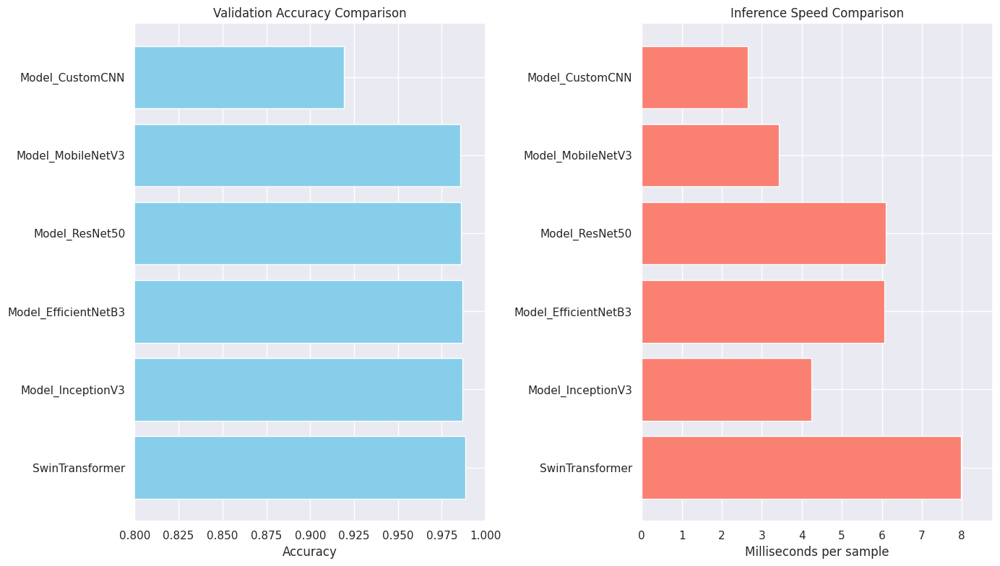

In [ ]:
# Create and display comparison table with Swin included
comparison_df = create_comparison_table(model_metrics)
print("\nModel Performance Comparison:")
print(comparison_df.to_string(index=False))

# Visualization with Swin
plt.figure(figsize=(14, 8))
plt.subplot(121)

# Sort models by validation accuracy for better visualization
sorted_models = sorted(model_metrics.items(), key=lambda x: x[1]['val_accuracy'], reverse=True)

# Plot accuracy
plt.barh([m[0] for m in sorted_models],
        [m[1]['val_accuracy'] for m in sorted_models],
        color='skyblue')
plt.title('Validation Accuracy Comparison')
plt.xlabel('Accuracy')
plt.xlim(0.8, 1.0)  # Adjust based on your metrics

# Plot inference time
plt.subplot(122)
plt.barh([m[0] for m in sorted_models],
        [m[1]['inference_time'] for m in sorted_models],
        color='salmon')
plt.title('Inference Speed Comparison')
plt.xlabel('Milliseconds per sample')
plt.xlim(0, max([m[1]['inference_time'] for m in sorted_models]) * 1.1)

plt.tight_layout()
plt.show()

## 8. Examine the errors of ResNet on the test data


In [ ]:
# Storage lists for predictions, probabilities and true labels
y_pred = []
y_pred_proba = []
y_true = []


# Iterate over the dataset
for image_batch, label_batch in test_dataset_resnet:
    y_true.append(label_batch)
    preds = model_resnet.predict(image_batch, verbose=0)
    y_pred_proba.append(preds)
    y_pred.append(np.argmax(preds, axis=-1))

# Concatenate and convert correct and predicted labels
correct_labels = tf.concat([item for item in y_true], axis = 0)
correct_labels = tf.cast(correct_labels, "int64")
predicted_labels = tf.concat([item for item in y_pred], axis = 0)

**Take a look at the most common mistakes.**

**Collect wrongly predicted images to investigate the reasons.**

In [ ]:
# Check predictions and store them in arrays
y_true = []
y_pred = []
images = []
for image, label in test_dataset.unbatch():
    # Reshape for model compatibility
    image_reshaped = tf.reshape(image, shape=(1,224,224,3))
    # Preprocess for resnet
    image_processed = preprocess_input(image_reshaped)
    # Predict most likely class
    prediction = model_resnet.predict(image_processed, verbose=0)
    prediction = np.argmax(prediction, axis=-1)
    # Check if prediction and true label are not equal
    if prediction != label:
        images.append(image / 255.)
        y_pred.append(prediction)
        y_true.append(label)

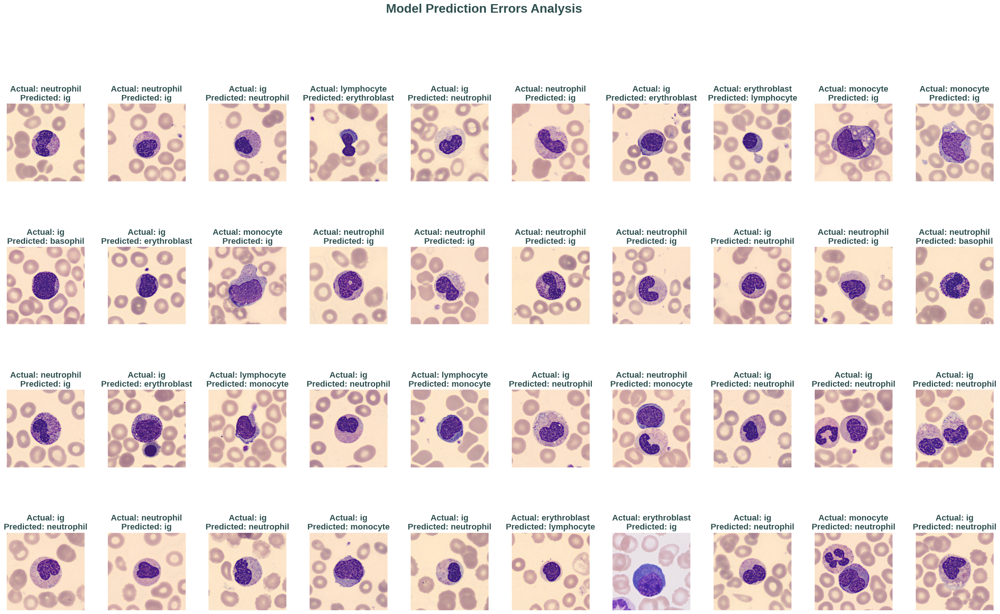

In [ ]:
# Plot wrongly predicted images with improved text
fig, axes = plt.subplots(4, 10, figsize=(34, 18))  # Larger figure size
plt.subplots_adjust(hspace=0.6, wspace=0.3)  # Increased vertical spacing

title_style = {
    'fontsize': 16,       # Increased from default ~10
    'fontweight': 'bold',
    'color': '#2F4F4F',   # Dark slate gray for better contrast
    'verticalalignment': 'baseline'
}

for counter, axis in enumerate(axes.flatten()):
    try:
        # Plot image
        axis.imshow(images[counter])

        # Create descriptive title with error analysis
        true_name = class_names[y_true[counter].numpy()]
        pred_name = class_names[y_pred[counter].item()]
        title_text = f"Actual: {true_name}\nPredicted: {pred_name}"

        # Add styled title
        axis.set_title(title_text, **title_style)

        # Remove axis ticks
        axis.set_xticks([])
        axis.set_yticks([])

    except IndexError:
        # Handle case where there are fewer errors than subplots
        axis.axis('off')

# Add super title for the entire figure
plt.suptitle("Model Prediction Errors Analysis",
            fontsize=24, y=1.02,
            fontweight='bold', color='#2F4F4F')

plt.show()


### 8.1 Misclassifications with GradCam

In [ ]:
##############################
### NEW GRAD-CAM ADDITIONS ###
import cv2
from tensorflow.keras.models import Model

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # Access the ResNet50 base model
    base_model = model.layers[1]

    # Create gradient model using the base model
    grad_model = tf.keras.models.Model(
        [base_model.input],
        [base_model.get_layer(last_conv_layer_name).output, base_model.output]
    )

    # Then compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def plot_gradcam(img, heatmap, alpha=0.4):
    # Rescale heatmap to 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = plt.colormaps.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)
    return superimposed_img

# Identify last conv layer from ResNet
last_conv_layer_name = "conv5_block3_out"  # From your model summary
### END OF GRAD-CAM ADDITIONS ###

# ... [Keep all your existing code until the "Examine errors" section] ...

# 5. Examine the errors of ResNet on the test data
# Modified version to collect Grad-CAM data
# Check predictions and store them in arrays
y_true = []
y_pred = []
images = []
heatmaps = []

### MODIFIED ERROR COLLECTION ###
for image, label in test_dataset.unbatch():
    try:
        # Preprocess image for ResNet
        image_reshaped = tf.reshape(image, shape=(1,224,224,3))
        image_processed = preprocess_input(image_reshaped)

        # Get prediction
        prediction = model_resnet.predict(image_processed, verbose=0)
        pred_class = np.argmax(prediction, axis=-1)[0]

        # Only store errors
        if pred_class != label.numpy():
            # Generate Grad-CAM
            heatmap = make_gradcam_heatmap(image_processed, model_resnet,
                                         last_conv_layer_name, pred_class)
            heatmap = cv2.resize(heatmap, (224, 224))  # Resize heatmap to image size

            # Store data
            images.append(image.numpy().astype("uint8"))
            y_pred.append(pred_class)
            y_true.append(label.numpy())
            heatmaps.append(heatmap)
    except Exception as e:
        print(f"Error processing image: {str(e)}")

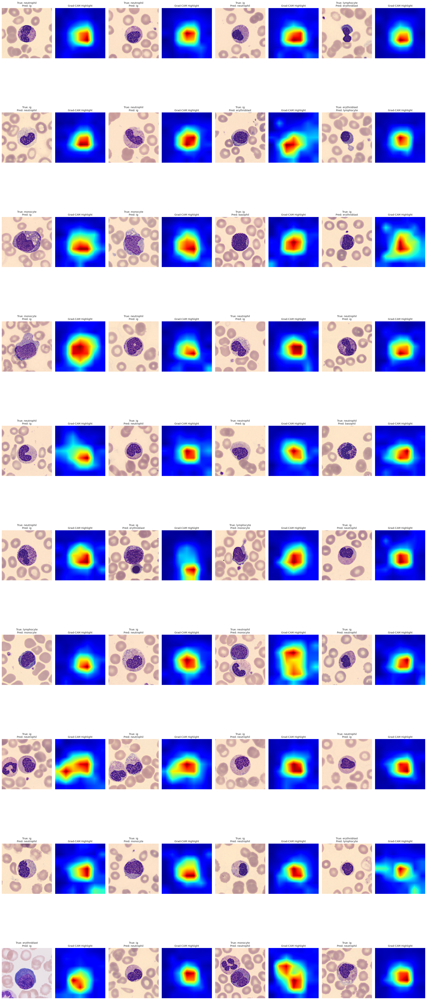

In [ ]:
#####################
### MODIFIED PLOTTING WITH GRAD-CAM ###
# Plot wrongly predicted images with Grad-CAM
num_images = min(len(images), 40)  # Limit to 40 images for visibility
examples_per_row = 4               # Number of examples to show per row
n_cols = examples_per_row * 2      # Each example has 2 images (orig + heatmap)
n_rows = int(np.ceil(num_images / examples_per_row))

plt.figure(figsize=(24, 6 * n_rows))

for i in range(num_images):
    row = i // examples_per_row
    pos_in_row = i % examples_per_row

    # Calculate subplot positions (1-based index)
    original_pos = row * n_cols + (pos_in_row * 2) + 1
    heatmap_pos = original_pos + 1

    # -- Plot Original Image --
    plt.subplot(n_rows, n_cols, original_pos)
    plt.imshow(images[i]/255.)
    plt.title(f"True: {class_names[y_true[i]]}\nPred: {class_names[y_pred[i]]}", fontsize=10)
    plt.axis('off')

    # -- Plot Grad-CAM Heatmap --
    plt.subplot(n_rows, n_cols, heatmap_pos)
    superimposed_img = plot_gradcam(images[i]/255., heatmaps[i], alpha=0.8)
    plt.imshow(superimposed_img)
    plt.title("Grad-CAM Highlight", fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()


-----------

In [ ]:
##############
def plot_gradcam(img_normalized, heatmap, alpha=0.4):
    """
    Generates an image overlayed with Grad-CAM heatmap using correct alpha blending.

    Args:
        img_normalized (np.array): Original image normalized to [0, 1], shape (H, W, 3)
        heatmap (np.array): Grad-CAM heatmap in range [0, 1], shape (H, W)
        alpha (float): Heatmap opacity (0-1 where 0=transparent, 1=opaque)

    Returns:
        np.array: Blended image in [0, 1], shape (H, W, 3)
    """
    # 1. Ensure heatmap is 2D
    if heatmap.ndim == 3:
        heatmap = np.squeeze(heatmap)

    # 2. Upscale heatmap to original image size
    heatmap_resized = cv2.resize(heatmap, (img_normalized.shape[1], img_normalized.shape[0]))

    # 3. Normalize heatmap to 0-255 and apply colormap
    heatmap_uint8 = np.uint8(255 * heatmap_resized)
    jet = plt.colormaps['jet']  # Use up-to-date Matplotlib colormap access
    jet_heatmap = jet(heatmap_uint8)[..., :3]  # Ignore alpha channel

    # 4. Convert heatmap from [0,1] to match image's normalized range
    jet_heatmap = jet_heatmap.astype(np.float32)

    # 5. Alpha blending formula: (heatmap * alpha) + (original * (1 - alpha))
    blended = jet_heatmap * alpha + img_normalized * (1 - alpha)

    # 6. Normalize and return
    blended_normalized = np.clip(blended, 0, 1)
    return blended_normalized

# Configuration
fig_width = 18  # Adjusted for better visibility of 3 samples/row
fig_height = 8 * n_rows  # Adjust height based on total rows


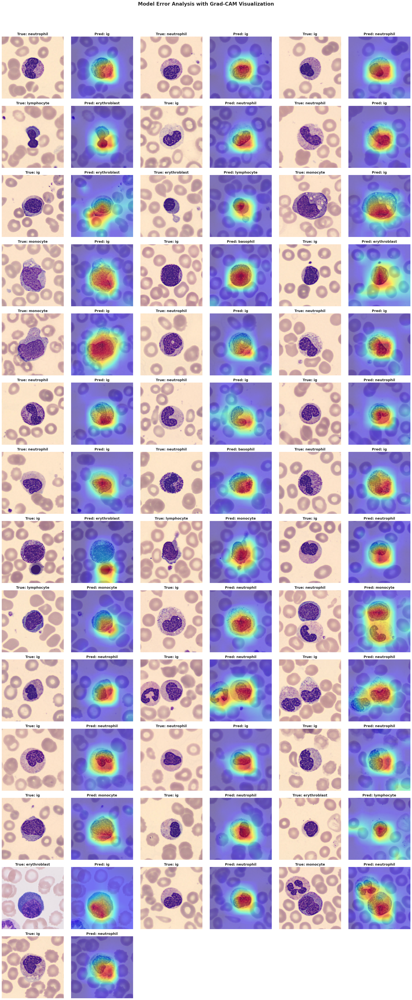

In [ ]:
#########################
# Configuration
samples_per_row = 3  # Three samples per row (each sample has original + heatmap)
figure_title = "Model Error Analysis with Grad-CAM Visualization"  # Custom title
n_cols = samples_per_row * 2
n_rows = int(np.ceil(num_images / samples_per_row))

# Font & spacing settings
title_font = {'fontsize': 14, 'fontweight': 'bold'}
figure_suptitle_font = {'fontsize': 20, 'fontweight': 'bold', 'y': 1.02}

# Create figure (reduced vertical spacing)
plt.figure(figsize=(24, 4 * n_rows))  # Reduce height from '6' to '5' multiplier
plt.subplots_adjust(hspace=0.2, wspace=0.1)  # Adjust spacing between subplots

# Add figure title
plt.suptitle(figure_title, **figure_suptitle_font)

for i in range(num_images):
    # Prepare images
    original_img = images[i]/255.
    heatmap_img = plot_gradcam(original_img.astype(np.float32), heatmaps[i], alpha=0.5)

    # Calculate grid positions
    row = i // samples_per_row
    col = (i % samples_per_row) * 2  # Each sample spans 2 columns

    # Plot original with true label
    ax1 = plt.subplot(n_rows, n_cols, row * n_cols + col + 1)
    plt.imshow(original_img)
    ax1.set_title(f"True: {class_names[y_true[i]]}", **title_font)
    plt.axis('off')

    # Plot heatmap with predicted label
    ax2 = plt.subplot(n_rows, n_cols, row * n_cols + col + 2)
    plt.imshow(heatmap_img)
    ax2.set_title(f"Pred: {class_names[y_pred[i]]}", **title_font)
    plt.axis('off')

plt.tight_layout()
plt.show()


### 8.2 Correct Classifications with Gradcam

In [ ]:
from contextlib import contextmanager, redirect_stderr
import os

@contextmanager
def suppress_tf_errors():
    """Context manager to suppress TensorFlow warnings and specific errors"""
    # Redirect stderr to devnull
    with open(os.devnull, 'w') as f:
        with redirect_stderr(f):
            try:
                yield
            except Exception as e:
                if "slice index 7 of dimension 1" not in str(e):
                    raise  # Re-raise unexpected exceptions


In [ ]:
# ========== Collect 40 CORRECTLY Predicted Samples ==========
correct_images = []
correct_y_true = []
correct_y_pred = []
correct_heatmaps = []

max_samples = 40  # Total samples to process including failures
sample_limit = 40  # Number of correct samples we want

# Filter out the specific TensorFlow error message
with suppress_tf_errors():
    processed = 0
    correct_counter = 0

    for image, label in test_dataset.unbatch():
        # Early exit conditions
        if processed >= max_samples or correct_counter >= sample_limit:
            break

        try:
            processed += 1  # Count total processed samples

            # Reshape and preprocess
            image_reshaped = tf.reshape(image, shape=(1,224,224,3))
            image_processed = preprocess_input(image_reshaped)

            # Predict
            prediction = model_resnet.predict(image_processed, verbose=0)
            pred_class = np.argmax(prediction, axis=-1)[0]
            true_class = label.numpy()

            if pred_class == true_class:
                # Generate Grad-CAM
                heatmap = make_gradcam_heatmap(
                    image_processed,
                    model_resnet,
                    last_conv_layer_name,
                    pred_class
                )
                heatmap = cv2.resize(heatmap, (224, 224))

                # Store data
                correct_images.append(image.numpy().astype("uint8"))
                correct_y_pred.append(pred_class)
                correct_y_true.append(true_class)
                correct_heatmaps.append(heatmap)

                correct_counter += 1  # Only increment for correct samples

        except Exception as e:
            if "slice index 7 of dimension 1" not in str(e):
                print(f"Error processing image: {str(e)}")

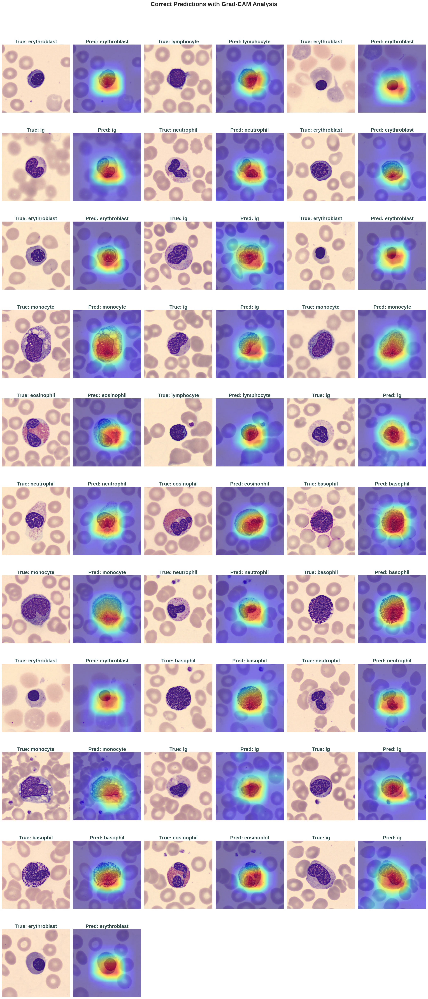

In [ ]:
# ========== Plotting Configuration ==========
samples_per_row = 3
n_cols = samples_per_row * 2
n_rows = int(np.ceil(len(correct_images) / samples_per_row))
plt.figure(figsize=(24, 5 * n_rows))  # Increased figure height
plt.subplots_adjust(hspace=0.3, wspace=0.15)  # More vertical space

# Main title with increased size
plt.suptitle("Correct Predictions with Grad-CAM Analysis",
            fontsize=24, y=1.02, fontweight='bold')

# Larger text parameters
title_style = {
    'fontsize': 20,  # Increased from 14
    'fontweight': 'bold',
    'color': '#2F4F4F'  # Darker color for better contrast
}

label_style = {
    'fontsize': 12,  # Optional: Increase label sizes if needed
    'color': '#696969'
}

for i in range(len(correct_images)):
    # Prepare images
    original_img = correct_images[i] / 255.0
    heatmap_img = plot_gradcam(
        original_img.astype(np.float32),
        correct_heatmaps[i],
        alpha=0.5
    )

    # Grid positions
    row = i // samples_per_row
    col = (i % samples_per_row) * 2

    # Original image
    ax1 = plt.subplot(n_rows, n_cols, row * n_cols + col + 1)
    plt.imshow(original_img)
    plt.title(f"True: {class_names[correct_y_true[i]]}", **title_style)
    plt.axis('off')

    # Optional: Add xlabel if needed
    # plt.xlabel("Input Image", **label_style)

    # Heatmap overlay
    ax2 = plt.subplot(n_rows, n_cols, row * n_cols + col + 2)
    plt.imshow(heatmap_img)
    plt.title(f"Pred: {class_names[correct_y_pred[i]]}", **title_style)
    plt.axis('off')

    # Optional: Add xlabel if needed
    # plt.xlabel("Grad-CAM Heatmap", **label_style)

plt.tight_layout()
plt.show()
